# CS166 - Final Assignment: Modeling Blindness

## Imports

In [1]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import random
from enum import Enum
import matplotlib.animation as animation
from matplotlib.gridspec import GridSpec
import copy
import seaborn as sns
from tqdm.notebook import tqdm
import pandas as pd
import seaborn as sns
from scipy import stats 
from scipy.stats import binom

## Blindness Model

In [2]:
class Status(Enum):
    "Represents the states/status a node can assume"
    SUSCEPTIBLE = 0
    INFECTED = 1
    BLIND = 2
    RESISTANT = 3
    DEAD = 4

In [3]:
class BlindnessStage(Enum):
    "Represents the blidness types/stages a node can assume"
    NONE = 0
    NEWLY_BLIND = 1
    ADAPTED_BLIND = 2
    SIGHTED = 3  # resistant individuals

In [4]:
class BlindnessModel:
    """
    A network-based simulation model for studying the spread and impact of a blindness pandemic.

    Nodes represent individuals who can transition between states (Susceptible, Infected, New Blind, Adapted, Resistant, Dead).
    The model dynamically updates node attributes and edge weights based on infection, adaptation, survival, and social interactions.

    Attributes:
        G (networkx.Graph): The network representing individuals and their relationships.
        population (int): Total number of nodes in the network.
        initial_infected (int): Number of nodes initially infected.
        resistant_count (int): Number of nodes initially resistant (sighted).
        adaptation_time (int): Minimum steps before a blind node can adapt.
        adaptation_p (float): Probability that a newly blind node adapts.
        p_infection (float): Base probability of infection transmission across an edge.
        alpha (float): Weight controlling survival rate adaptation.
        beta (float): Weight controlling edge reinforcement dynamics.
        gamma (float): Stress factor based on survival rate differences.
        stats (dict): Statistics tracked during simulation steps.
        viz (VisualizationManager): Visualization manager for plotting the network.
    """
    def __init__(self, population, initial_infected, resistant_count, 
                 adaptation_time=10, adaptation_p=0.3, p_infection=0.7, alpha=0.05, beta=0.4, gamma=0.5, custom_graph=None):
        self.population = population
        self.initial_infected = initial_infected
        self.resistant_count = resistant_count
    
        self.current_step = 0
        self.adaptation_time = adaptation_time
        self.adaptation_p = adaptation_p
        self.p_infection = p_infection
        
        # parameters
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma
        
        if custom_graph is not None:
            self.G = custom_graph
        else:
            k = min(4, max(1, population - 1))
            self.G = nx.watts_strogatz_graph(n=population, k=k, p=0.1)
        self.G.pos = nx.spring_layout(self.G)
        
        for (u, v) in self.G.edges():
            self.G[u][v]['weight'] = random.uniform(0.05, 0.7)
        
        for i in range(population):
            self.G.nodes[i]['status'] = Status.SUSCEPTIBLE
            self.G.nodes[i]['blindness_stage'] = BlindnessStage.NONE
            self.G.nodes[i]['survival_rate'] = random.uniform(0, 1.0)
            self.G.nodes[i]['time_since_infection'] = 0
            self.G.nodes[i]['time_since_blindness'] = 0
            self.G.nodes[i]['new_blind_neighbor_streak'] = 0 # to be used on death scenarios
            
        infected_nodes = random.sample(range(population), initial_infected)
        for node in infected_nodes:
            self.G.nodes[node]['status'] = Status.INFECTED

        resistant_candidates = [i for i in range(population) if i not in infected_nodes]
        if resistant_candidates and resistant_count > 0:
            resistant_nodes = random.sample(resistant_candidates, min(resistant_count, len(resistant_candidates)))
            for node in resistant_nodes:
                self.G.nodes[node]['status'] = Status.RESISTANT
                self.G.nodes[node]['blindness_stage'] = BlindnessStage.SIGHTED
        
        self.stats = {}
        self.update_stats()
        self.viz = VisualizationManager(self)
    
    def spread_blindness(self):
        """
        Spread blindness across the network by infecting susceptible neighbors
        and transitioning infected nodes to the blind state after a fixed time.
        """
        newly_infected = []
        # identify all nodes that will become infected or change state
        for i in self.G.nodes():
            
            if self.G.nodes[i]['status'] == Status.INFECTED:
                self.G.nodes[i]['time_since_infection'] += 1
                
                # mark nodes that will transition to BLIND
                if self.G.nodes[i]['time_since_infection'] >= 3:
                    newly_infected.append((i, Status.BLIND, BlindnessStage.NEWLY_BLIND))
                    
                # check which neighboring nodes will become infected
                for neighbor in list(self.G.neighbors(i)):
                    if (self.G.has_node(neighbor) and
                        self.G.nodes[neighbor]['status'] == Status.SUSCEPTIBLE and
                        random.random() < self.G[i][neighbor]['weight'] * self.p_infection):
                        newly_infected.append((neighbor, Status.INFECTED, self.G.nodes[neighbor]['blindness_stage']))

        # apply all the updates at once after determining all state changes
        for node, new_status, new_blindness_stage in newly_infected:
            if self.G.has_node(node):
                self.G.nodes[node]['status'] = new_status
                if new_status == Status.BLIND:
                    self.G.nodes[node]['blindness_stage'] = new_blindness_stage
                    self.G.nodes[node]['time_since_blindness'] = 0
                elif new_status == Status.INFECTED:
                    self.G.nodes[node]['time_since_infection'] = 0

    def update_blindness_stage(self):
        """
        Update blindness stages for nodes that are newly blind.
        Nodes can adapt to blindness after a minimum adaptation time with a given probability.
        """
        stage_updates = []
        for i in self.G.nodes():
            if self.G.nodes[i]['status'] == Status.BLIND:
                if self.G.nodes[i]['blindness_stage'] == BlindnessStage.NEWLY_BLIND:
                    self.G.nodes[i]['time_since_blindness'] += 1
                    if (self.G.nodes[i]['time_since_blindness'] >= self.adaptation_time and
                        random.random() < self.adaptation_p):
                        stage_updates.append((i, BlindnessStage.ADAPTED_BLIND))
    
        # apply all stage updates at once
        for node, new_stage in stage_updates:
            if self.G.has_node(node):
                self.G.nodes[node]['blindness_stage'] = new_stage


    def update_edge_weights(self):
        """
        Update the edge weights based on survival differences and social dynamics.
        Reinforces or weakens edges, and removes edges that fall below a minimum strength.
        Also updates nodes' survival rates based on neighbors' conditions.
        """
        edges_to_remove = []
        components = list(nx.connected_components(self.G))

        for component in components:
            for node_i in component:
                for node_j in self.G.neighbors(node_i):
                    if node_j in component:
                        c_i = self.G.nodes[node_i]['survival_rate']
                        c_j = self.G.nodes[node_j]['survival_rate']
                        w_ij = self.G[node_i][node_j]['weight']
                        
                        # edge update calculation
                        delta_w_ij = self.beta * w_ij * (1 - w_ij) * (1 - self.gamma * abs(c_i - c_j))
                        new_weight = max(0, min(1, w_ij + delta_w_ij))
                        self.G[node_i][node_j]['weight'] = new_weight
                        
                        # removing edges
                        if new_weight <= 0.05:
                            edges_to_remove.append((node_i, node_j))
                            
                        delta_c_i = self.alpha * w_ij * (c_j - c_i) # survival rate
                        self.G.nodes[node_i]['survival_rate'] = max(0, min(1.0, self.G.nodes[node_i]['survival_rate'] + delta_c_i))
        
        for edge in edges_to_remove:
            if self.G.has_edge(*edge):
                self.G.remove_edge(*edge)

    def update_stats(self):
        """
        Calculate and update simulation statistics, including:
        - Node status counts (e.g., susceptible, infected, blind)
        - Cluster properties (e.g., average size, survival rates)
        - Average edge weight and total edge count.
        
        Returns:
            dict: Updated statistics for the current simulation step.
        """
        status_counts = {status: 0 for status in Status}
        for node in self.G.nodes():
            status_counts[self.G.nodes[node]['status']] += 1

        blindness_counts = {stage: 0 for stage in BlindnessStage}
        for node in self.G.nodes():
            blindness_counts[self.G.nodes[node]['blindness_stage']] += 1

        components = list(nx.connected_components(self.G))
        cluster_count = len(components)
        avg_cluster_size = sum(len(c) for c in components) / max(1, cluster_count)

        cluster_metrics = []
        for cluster in components:
            if len(cluster) > 0:
                resistant_percent = sum(1 for n in cluster if self.G.nodes[n]['blindness_stage'] == BlindnessStage.SIGHTED) / len(cluster)
                adapted_percent = sum(1 for n in cluster if self.G.nodes[n]['blindness_stage'] == BlindnessStage.ADAPTED_BLIND) / len(cluster)
                newly_blind_percent = sum(1 for n in cluster if self.G.nodes[n]['blindness_stage'] == BlindnessStage.NEWLY_BLIND) / len(cluster)
                cluster_metrics.append({
                    'size': len(cluster),
                    'resistant_percent': resistant_percent,
                    'adapted_percent': adapted_percent,
                    'newly_blind_percent': newly_blind_percent,
                    'avg_survival_rate': sum(self.G.nodes[n]['survival_rate'] for n in cluster) / len(cluster)
                })

        avg_edge_weight = 0
        if self.G.number_of_edges() > 0:
            avg_edge_weight = sum(data['weight'] for _, _, data in self.G.edges(data=True)) / self.G.number_of_edges()

        self.stats = {
            'step': self.current_step,
            'susceptible': status_counts[Status.SUSCEPTIBLE],
            'infected': status_counts[Status.INFECTED],
            'blind': status_counts[Status.BLIND],
            'resistant': status_counts[Status.RESISTANT],
            'newly_blind': blindness_counts[BlindnessStage.NEWLY_BLIND],
            'adapted_blind': blindness_counts[BlindnessStage.ADAPTED_BLIND],
            'sighted': blindness_counts[BlindnessStage.SIGHTED],
            'cluster_count': cluster_count,
            'avg_cluster_size': avg_cluster_size,
            'avg_edge_weight': avg_edge_weight,
            'edge_count': self.G.number_of_edges(),
            'cluster_metrics': cluster_metrics
        }
        return self.stats

    def step(self):
        """
        Advance the simulation by one step:
        - Spread blindness
        - Update blindness stages
        - Update edge weights
        - Evaluate death conditions based on survival, blindness, and network properties
        
        Returns:
            dict: Statistics snapshot after the step.
        """
        self.current_step += 1
        self.spread_blindness()
        self.update_blindness_stage()
        self.update_edge_weights()

        dead_nodes = []
        for node in list(self.G.nodes()):
            if self.G.nodes[node]['status'] == Status.DEAD:
                continue

            survival = self.G.nodes[node]['survival_rate']
            neighbors = list(self.G.neighbors(node))
            strong_bonds = [self.G[node][n]['weight'] for n in neighbors if self.G[node][n]['weight'] >= 0.7]

            # Death condition 1: low survival + no strong bonds after time >= 10
            if survival <= 0.2 and len(strong_bonds) == 0 and self.current_step >= 10:
                dead_nodes.append(node)
                continue

            # Death condition 2: no connections and is blind
            if len(neighbors) == 0 and self.G.nodes[node]['status'] == Status.BLIND:
                dead_nodes.append(node)
                continue

            # Death condition 3: mostly newly blind neighbors for 3 steps
            if len(neighbors) > 0:
                newly_blind_neighbors = sum(
                    1 for n in neighbors
                    if self.G.nodes[n]['blindness_stage'] == BlindnessStage.NEWLY_BLIND
                )
                if newly_blind_neighbors > len(neighbors) / 2:
                    self.G.nodes[node]['new_blind_neighbor_streak'] += 1
                else:
                    self.G.nodes[node]['new_blind_neighbor_streak'] = 0

                if self.G.nodes[node]['new_blind_neighbor_streak'] >= 10:
                    if random.random() < 0.7:
                        dead_nodes.append(node)
                        continue


        # apply changes after all nodes have been evaluated
        for node in dead_nodes:
            self.G.nodes[node]['status'] = Status.DEAD
            self.G.remove_edges_from(list(self.G.edges(node)))

        return self.update_stats()


    def run_simulation(self, steps=100):
        """
        Run the full simulation for a given number of steps or until no susceptible/infected nodes remain.

        Parameters:
            steps (int, optional): Maximum number of simulation steps to run. Default is 100.

        Returns:
            list of dict: Statistics collected after each step of the simulation.
        """
        results = []
        for _ in range(steps):
            status = self.step()
            results.append(status)
            if status['infected'] == 0 and status['susceptible'] == 0:
                break
        return results


## Visualization

In [5]:
class VisualizationManager:
    """Class to handle visualizations of the simulation"""
    
    def __init__(self, model):
        """Initialize visualization manager with a reference to the model"""
        self.model = model
        self.snapshots = {}
        # Initialize a fixed layout at the beginning
        self.model.G.pos = nx.spring_layout(self.model.G, seed=42)
    
    def visualize_network(self, save_snapshot=False, ax=None):
        """
        Enhanced visualization of the current state of the network

        Parameters:
        - save_snapshot: Whether to save this visualization as a snapshot
        - ax: Optional matplotlib axis to draw on
        """
        if ax is None:
            fig = plt.figure(figsize=(12, 8))
            ax = fig.add_subplot(111)
        else:
            fig = ax.figure

        # create a color map for nodes
        color_map = []
        for i in self.model.G.nodes():
            if self.model.G.nodes[i]['status'] == Status.SUSCEPTIBLE:
                color_map.append('green')
            elif self.model.G.nodes[i]['status'] == Status.INFECTED:
                color_map.append('red')
            elif  self.model.G.nodes[i]['status'] == Status.DEAD:
                color_map.append('gray')
            elif self.model.G.nodes[i]['status'] == Status.BLIND:
                if self.model.G.nodes[i]['blindness_stage'] == BlindnessStage.NEWLY_BLIND:
                    color_map.append('orange')
                else:  # ADAPTED_BLIND
                    color_map.append('purple')
            elif self.model.G.nodes[i]['status'] == Status.RESISTANT:
                color_map.append('blue')

        # get edge weights for visualization
        raw_weights = [self.model.G[u][v]['weight'] for u, v in self.model.G.edges()]
        if raw_weights:  # make sure there are edges
            min_w, max_w = min(raw_weights), max(raw_weights)

            # normalize edge widths to range [1, 8] for better visibility
            edge_widths = [
                1 + 7 * ((w - min_w) / (max_w - min_w + 1e-5))  # avoid division by zero
                for w in raw_weights
            ]

            # draw edges with variable width and color
            edges = nx.draw_networkx_edges(
                self.model.G, self.model.G.pos,
                width=edge_widths,
                edge_color=raw_weights,  # raw weights for color mapping
                edge_cmap=plt.cm.viridis,
                edge_vmin=min_w,  # min value for color mapping
                edge_vmax=max_w,   # max value for color mapping
                ax=ax
            )

            # colorbar for edge weights
            vmin = 0.0
            vmax = 1.0
            sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=vmin, vmax=vmax))
            sm.set_array([])
            cbar = plt.colorbar(sm, ax=ax, shrink=0.7, pad=0.05)
            cbar.set_label('Edge Weight (Connection Strength)')

        # draw the network nodes
        nx.draw_networkx_nodes(self.model.G, self.model.G.pos, node_color=color_map, node_size=300, ax=ax)

        # add node labels only if network is small
        if len(self.model.G.nodes()) <= 50:
            nx.draw_networkx_labels(self.model.G, self.model.G.pos, font_size=8, ax=ax)

        ax.set_title(f"Blindness Network - Step {self.model.current_step}")

        # legend
        legend_elements = [
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='Susceptible'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='Infected'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='orange', markersize=10, label='Newly Blind'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='purple', markersize=10, label='Adapted Blind'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='Resistant/Sighted'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', markersize=10, label='Dead')
        ]
        ax.legend(handles=legend_elements, loc='upper right', fontsize='small')

        # remove axis ticks and labels for cleaner look
        ax.set_xticks([])
        ax.set_yticks([])

        if save_snapshot:
            # save the current state as a snapshot
            G_copy = self.model.G.copy()
            # ensure the position attribute is copied
            nx.set_node_attributes(G_copy, {n: self.model.G.pos[n] for n in G_copy.nodes()}, 'pos')
            
            self.snapshots[self.model.current_step] = {
                'G': G_copy,
                'step': self.model.current_step,
                'pos': {n: self.model.G.pos[n].copy() for n in self.model.G.nodes()},
                'min_weight': min_w if raw_weights else 0,
                'max_weight': max_w if raw_weights else 1
            }

        return fig
    
    def visualize_snapshot(self, step, ax=None):
        """
        Visualize a previously saved snapshot using the same format as visualize_network

        Parameters:
        - step: The step number of the snapshot to visualize
        - ax: Optional matplotlib axis to draw on
        """
        if step not in self.snapshots:
            raise ValueError(f"No snapshot available for step {step}")

        if ax is None:
            fig = plt.figure(figsize=(12, 8))
            ax = fig.add_subplot(111)
        else:
            fig = ax.figure

        snapshot = self.snapshots[step]
        G = snapshot['G']
        pos = snapshot['pos']  # use the saved positions
        min_w = snapshot['min_weight']
        max_w = snapshot['max_weight']

        # create a color map
        color_map = []
        for i in G.nodes():
            if G.nodes[i]['status'] == Status.SUSCEPTIBLE:
                color_map.append('green')
            elif G.nodes[i]['status'] == Status.INFECTED:
                color_map.append('red')
            elif G.nodes[i]['status'] == Status.DEAD:
                color_map.append('gray')
            elif G.nodes[i]['status'] == Status.BLIND:
                if G.nodes[i]['blindness_stage'] == BlindnessStage.NEWLY_BLIND:
                    color_map.append('orange')
                else:  # ADAPTED_BLIND
                    color_map.append('purple')
            elif G.nodes[i]['status'] == Status.RESISTANT:
                color_map.append('blue')


        # get edge weights for visualization
        raw_weights = [G[u][v]['weight'] for u, v in G.edges()]
        if raw_weights:  # only if there are edges
            # normalize edge width
            edge_widths = [
                1 + 7 * ((w - min_w) / (max_w - min_w + 1e-5))  # avoid division by zero
                for w in raw_weights
            ]

            # draw edges with variable width and color
            edges = nx.draw_networkx_edges(
                G, pos,
                width=edge_widths,
                edge_color=raw_weights,  # raw weights for color mapping
                edge_cmap=plt.cm.viridis, 
                edge_vmin=min_w,  # min value for color mapping
                edge_vmax=max_w,   # max value for color mapping
                ax=ax
            )

            # add a colorbar for edge weights
            vmin = 0.0
            vmax = 1.0
            sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=vmin, vmax=vmax))
            sm.set_array([])
            cbar = plt.colorbar(sm, ax=ax, shrink=0.7, pad=0.05)
            cbar.set_label('Edge Weight (Connection Strength)')

        # draw the network nodes
        nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=300, ax=ax)

        # add node labels only if network is small
        if len(G.nodes()) <= 50:
            nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

        ax.set_title(f"Blindness Network - Step {step}")

        # legend
        legend_elements = [
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='Susceptible'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='Infected'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='orange', markersize=10, label='Newly Blind'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='purple', markersize=10, label='Adapted Blind'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='Resistant/Sighted'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', markersize=10, label='Dead')
        ]
        ax.legend(handles=legend_elements, loc='upper right', fontsize='small')

        # remove axis ticks and labels
        ax.set_xticks([])
        ax.set_yticks([])

        return fig
    
    def visualize_multiple_snapshots(self, steps):
        """
        Visualize multiple snapshots in a grid layout
        
        Parameters:
        - steps: List of step numbers to visualize
        """
        n_steps = len(steps)
        n_cols = min(3, n_steps)  # max 3 columns
        n_rows = (n_steps + n_cols - 1) // n_cols 
        
        fig = plt.figure(figsize=(18, 6 * n_rows))
        gs = GridSpec(n_rows, n_cols, figure=fig)
        
        # legend
        legend_elements = [
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='Susceptible'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='Infected'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='orange', markersize=10, label='Newly Blind'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='purple', markersize=10, label='Adapted Blind'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='Resistant/Sighted'),
            plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', markersize=10, label='Dead')
        ]
        fig.legend(handles=legend_elements, loc='upper center', ncol=5, fontsize='medium', 
                  bbox_to_anchor=(0.5, 0.98))
        
        for i, step in enumerate(steps):
            row = i // n_cols
            col = i % n_cols
            ax = fig.add_subplot(gs[row, col])
            
            # use the snapshot if available, otherwise create a placeholder
            if step in self.snapshots:
                self.visualize_snapshot(step, ax=ax)
            else:
                ax.text(0.5, 0.5, f"No data for Step {step}", 
                       horizontalalignment='center', verticalalignment='center')
                ax.set_title(f"Step {step} - Missing Data")
            
        plt.tight_layout(rect=[0, 0, 1, 0.95])  # adjust for the legend at the top
        return fig

## Simulation Organization

In [6]:
class BlindnessSimulation:
    """Main class to orchestrate the blindness spread simulation"""
    
    def __init__(self, population=100, initial_infected=5, resistant_count=1, adaptation_time=10, adaptation_p=0.3, p_infection=0.7, 
                alpha=0.05, beta=0.4, gamma=0.5, custom_graph=None):
        """Initialize the simulation with parameters"""
        self.model = BlindnessModel(population,initial_infected,resistant_count,adaptation_time=adaptation_time,adaptation_p=adaptation_p,
                                    p_infection=p_infection,alpha=alpha,beta=beta,gamma=gamma,custom_graph=custom_graph)
        self.viz = self.model.viz
    
    def run(self, steps=50):
        """Run the simulation for a specified number of steps"""
        return self.model.run_simulation(steps)
    
    def visualize_network(self):
        """Visualize the current state of the network"""
        return self.viz.visualize_network()
    
    def create_animation(self, steps=50):
        """Create an animation of the network evolution"""
        return self.viz.create_animation(steps)
    
    def visualize_snapshots(self, steps):
        """Visualize multiple snapshots of the network at specified steps"""
        return self.viz.visualize_multiple_snapshots(steps)

### General Run

/var/folders/fp/w4m5g40x00zggq40yjyhbvzm0000gn/T/ipykernel_80446/4047122207.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12, 8))


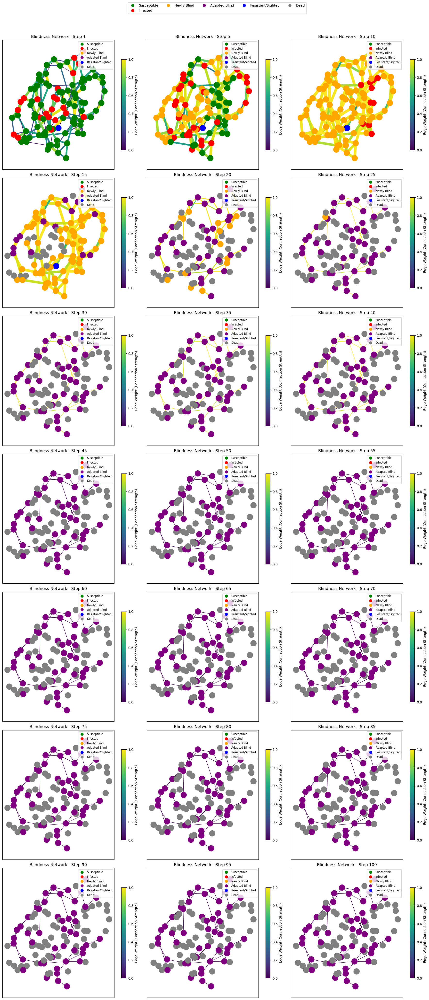

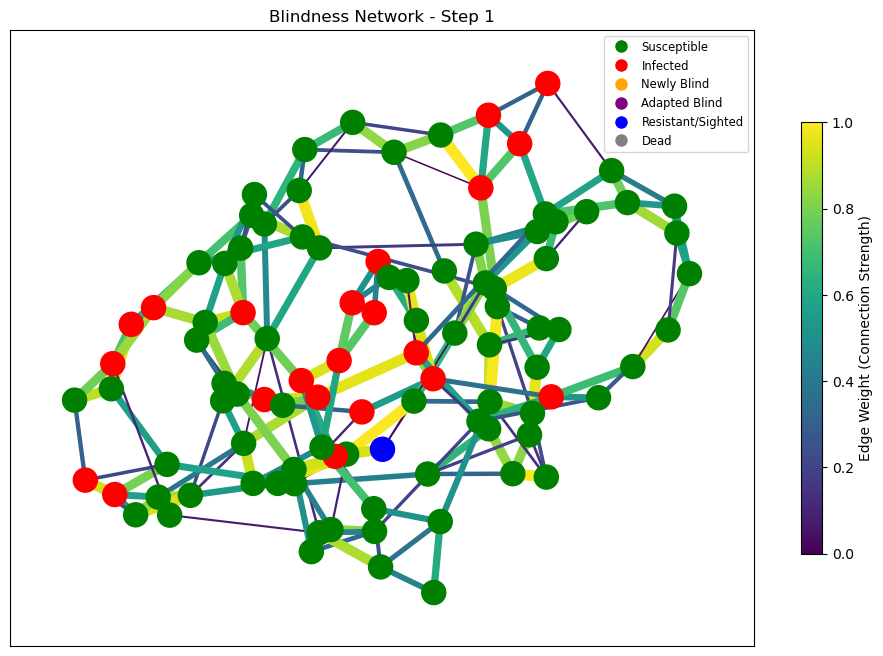

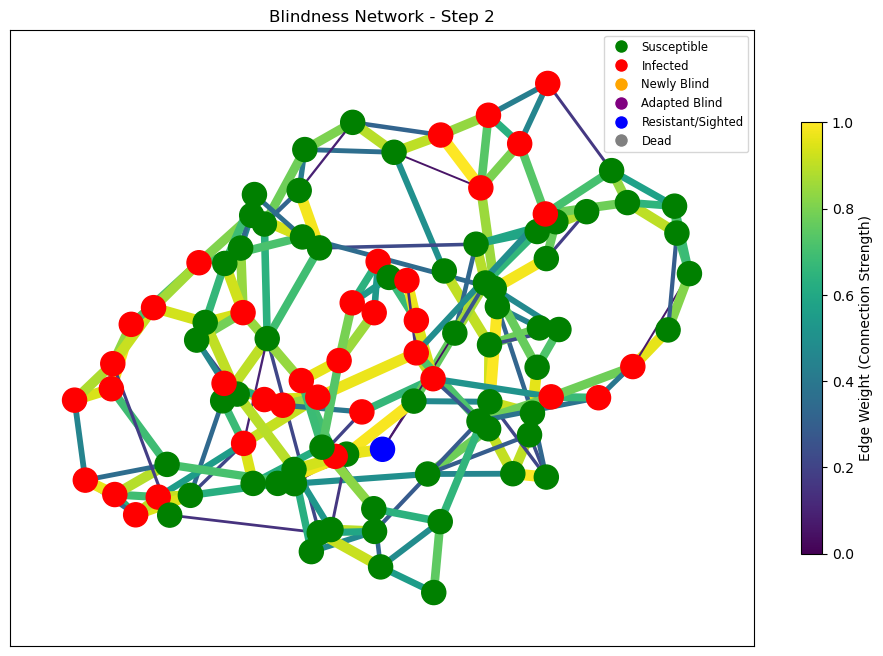

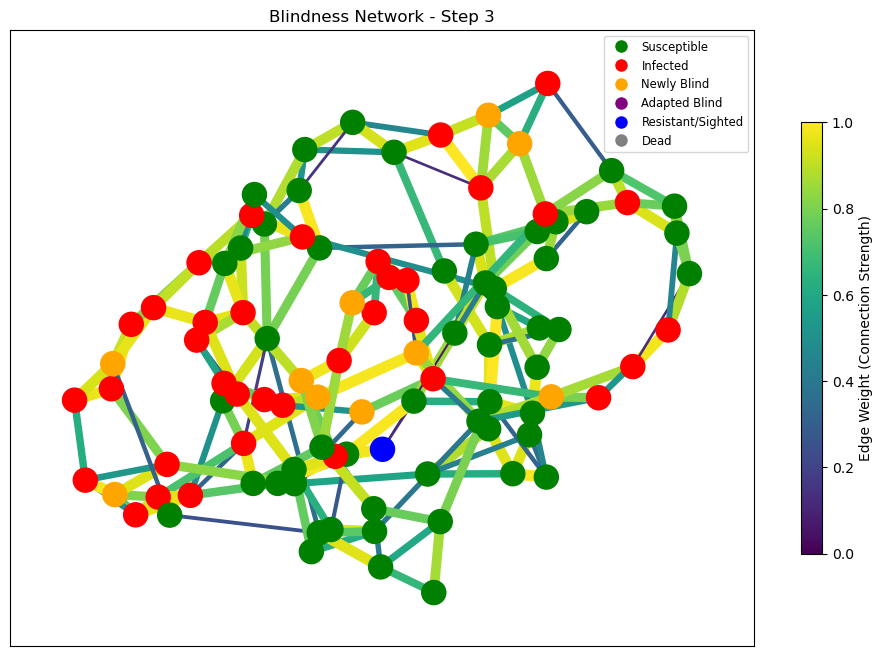

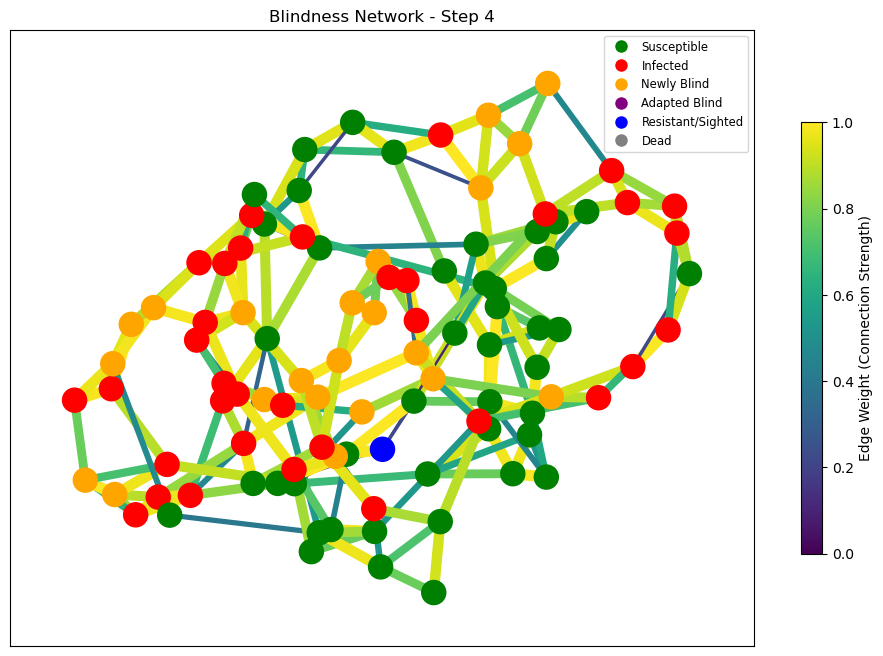

...

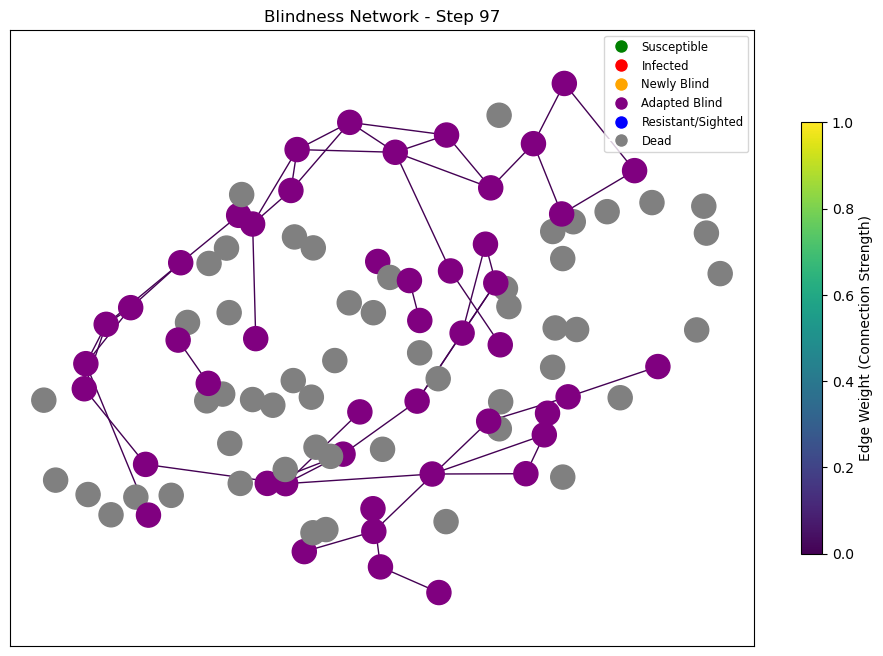

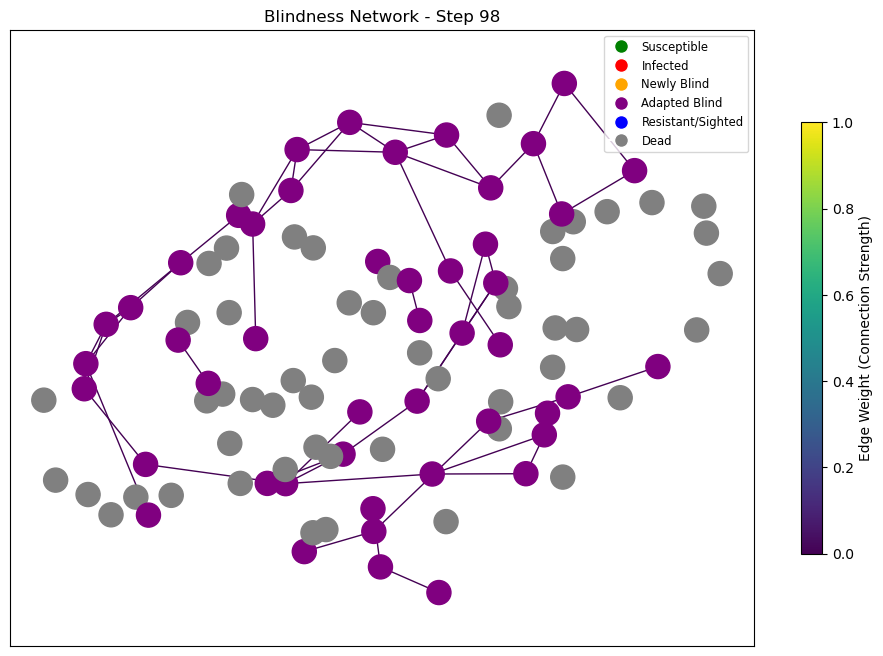

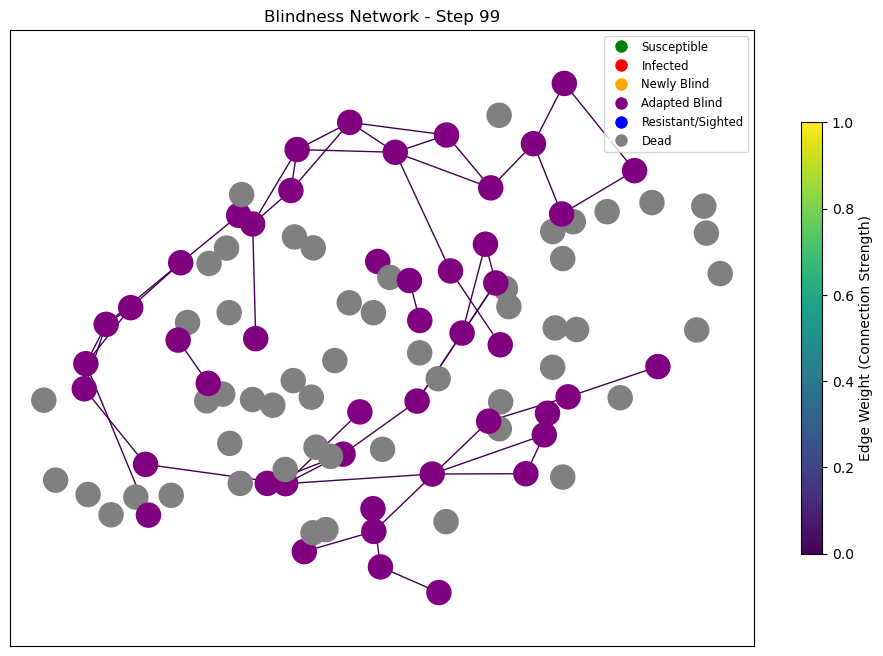

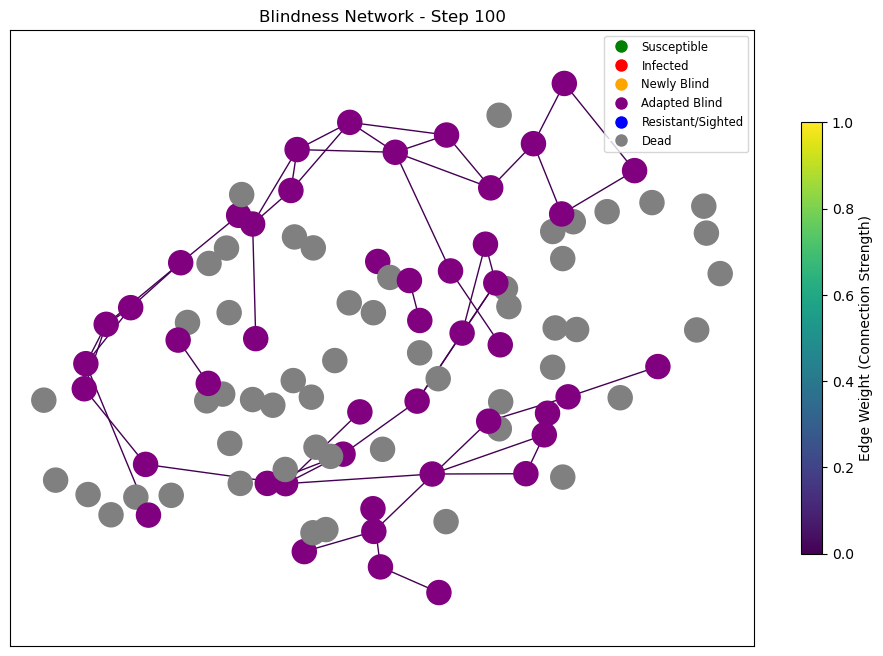

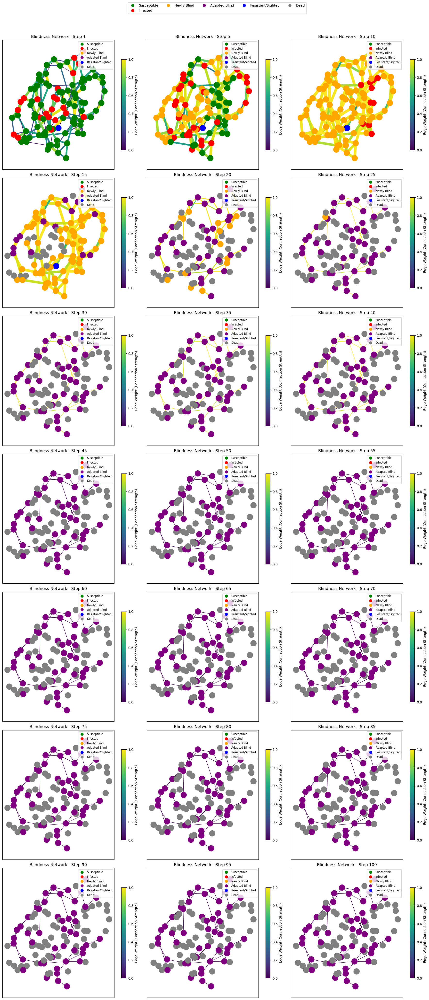

In [7]:
# create a simulation with parameters
sim = BlindnessSimulation(population=100, initial_infected=10, resistant_count=1)

# run to save snapshots
for step in range(100):
    sim.model.step()
    sim.viz.visualize_network(save_snapshot=True)

sim.visualize_snapshots([1, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100])


## Tests

### Test Case 1: No spontaneous state changes

This test aims to change that infection only happens if there is an infected node on the system. A susceptible node will stay susceptible if it is isolated.

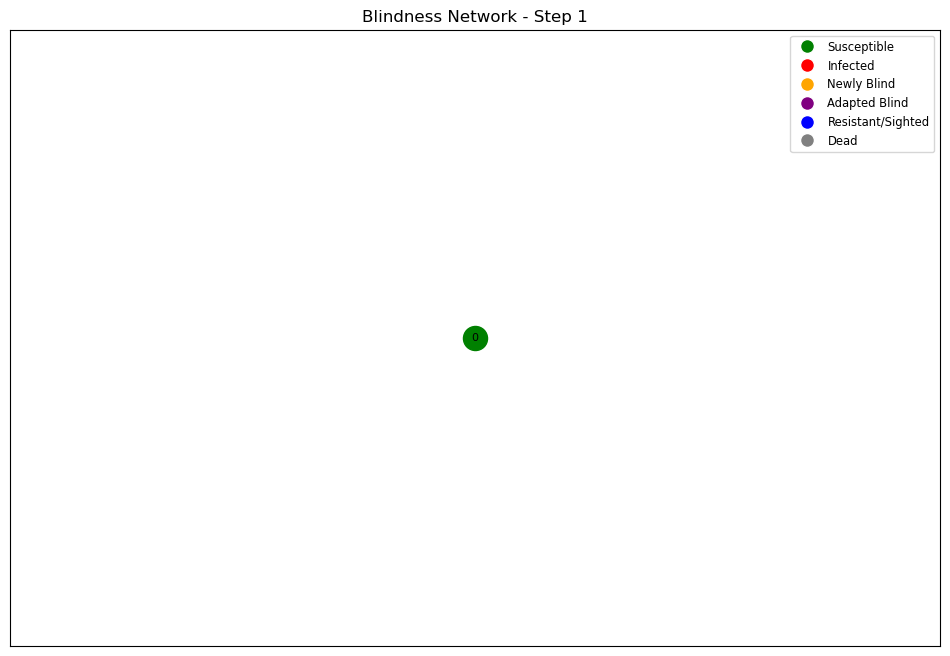

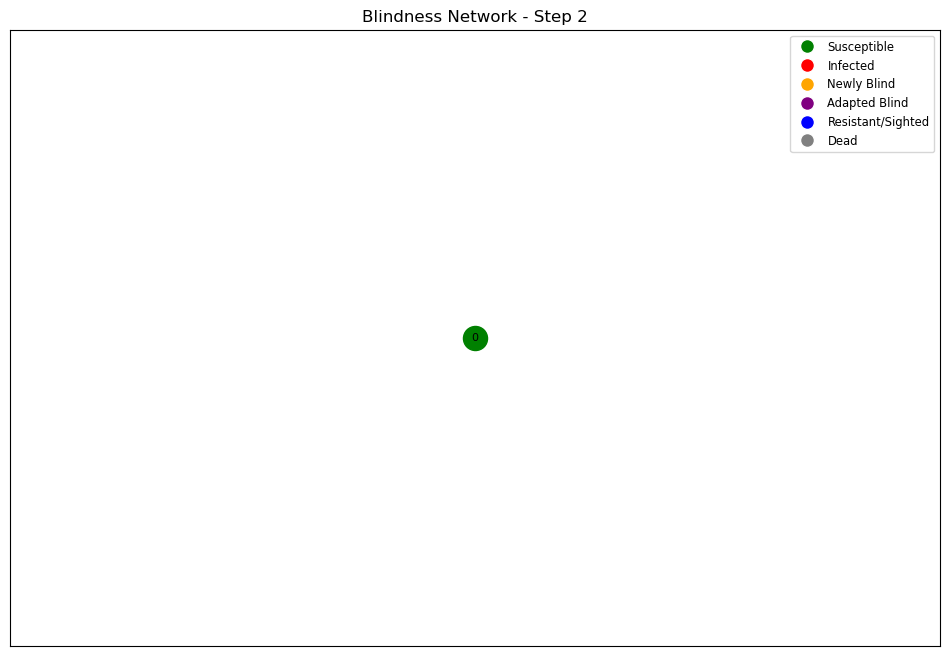

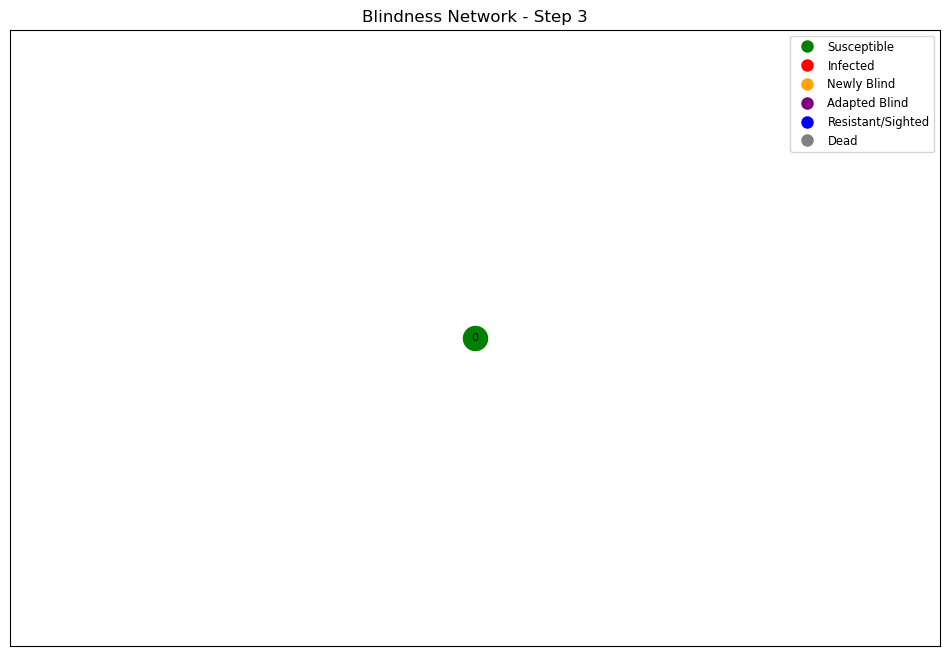

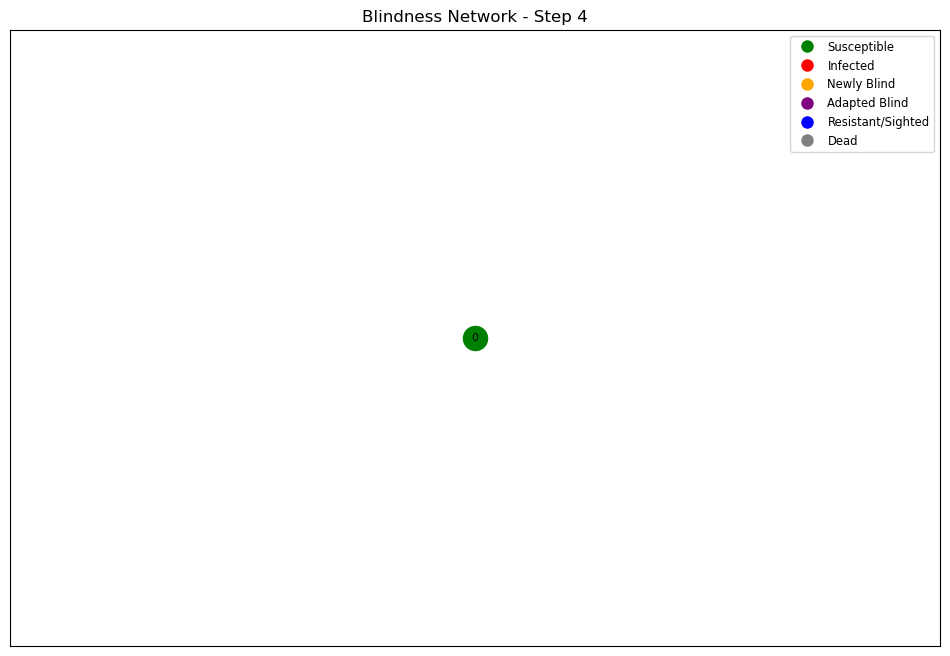

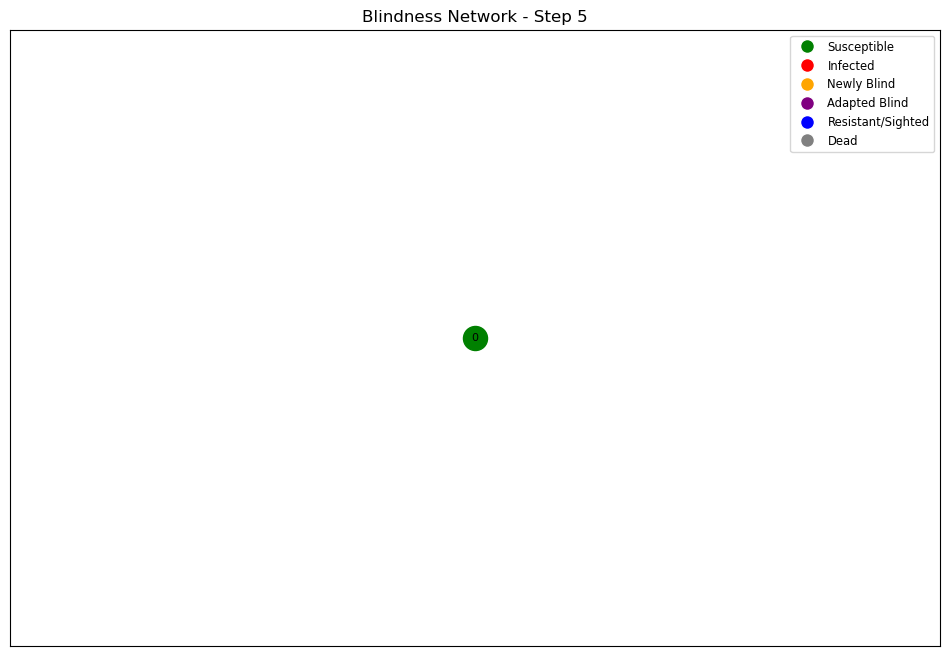

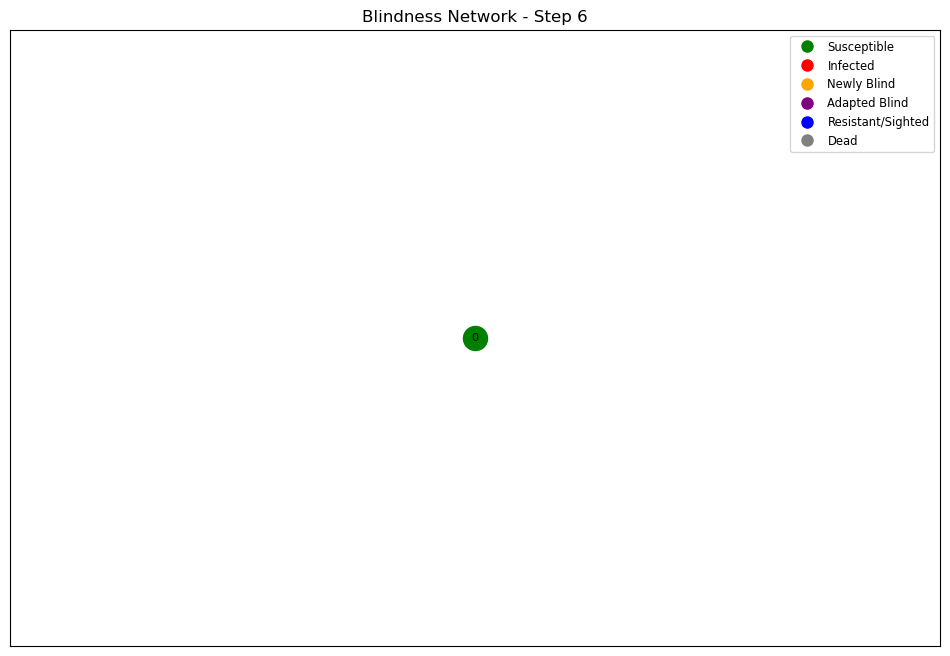

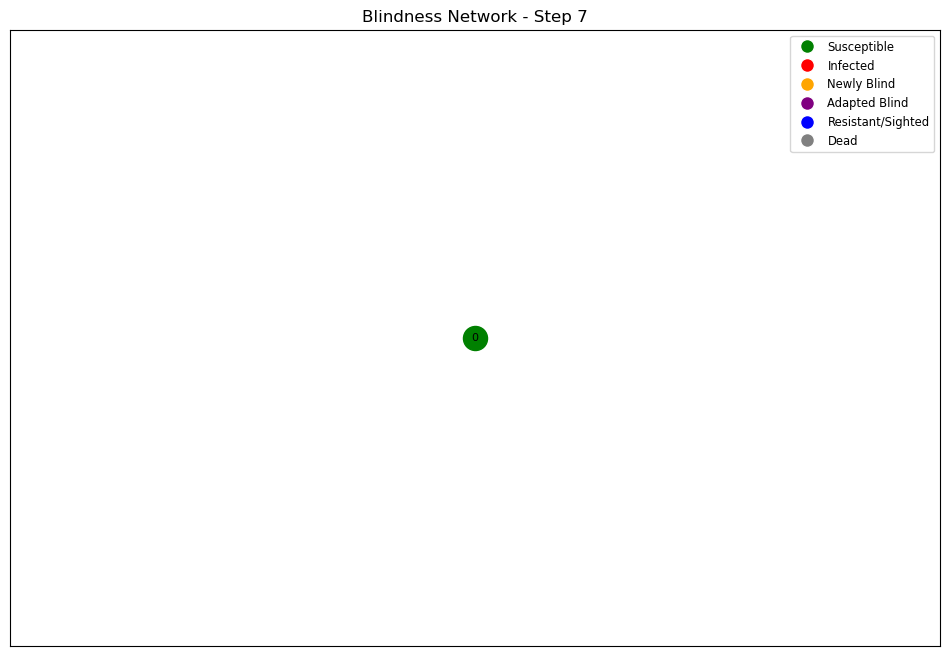

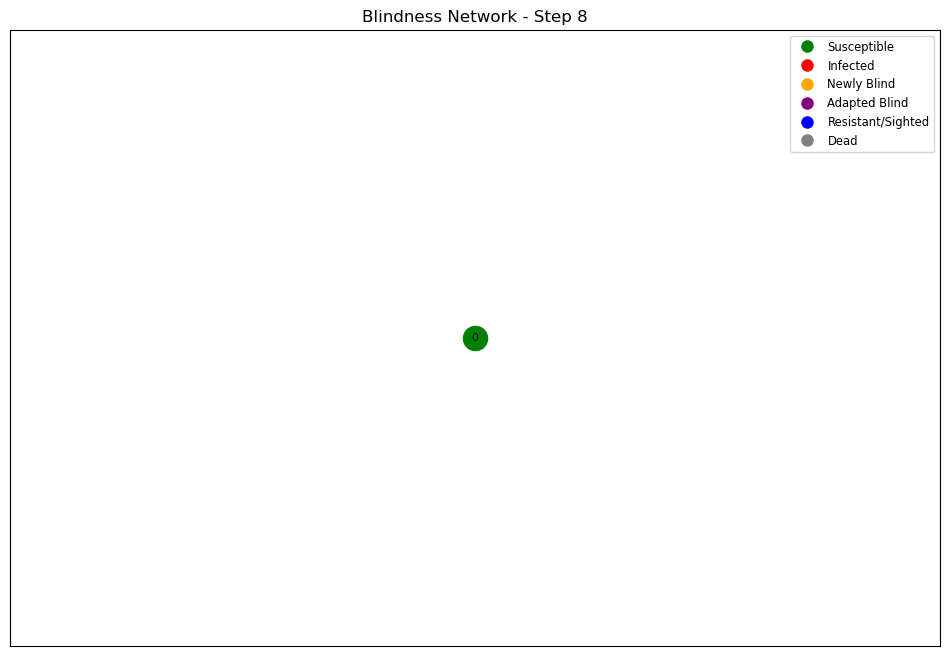

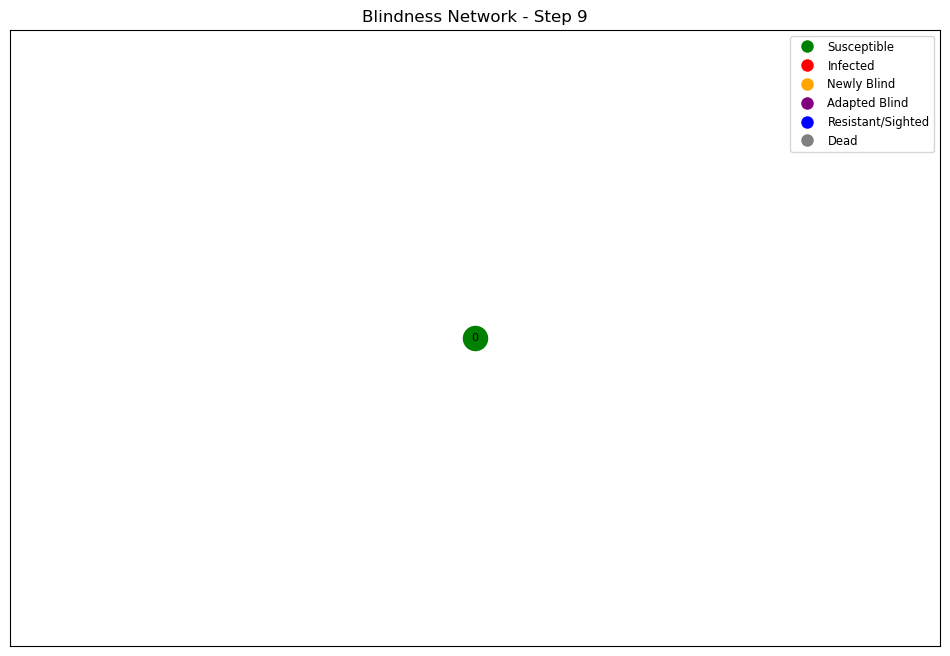

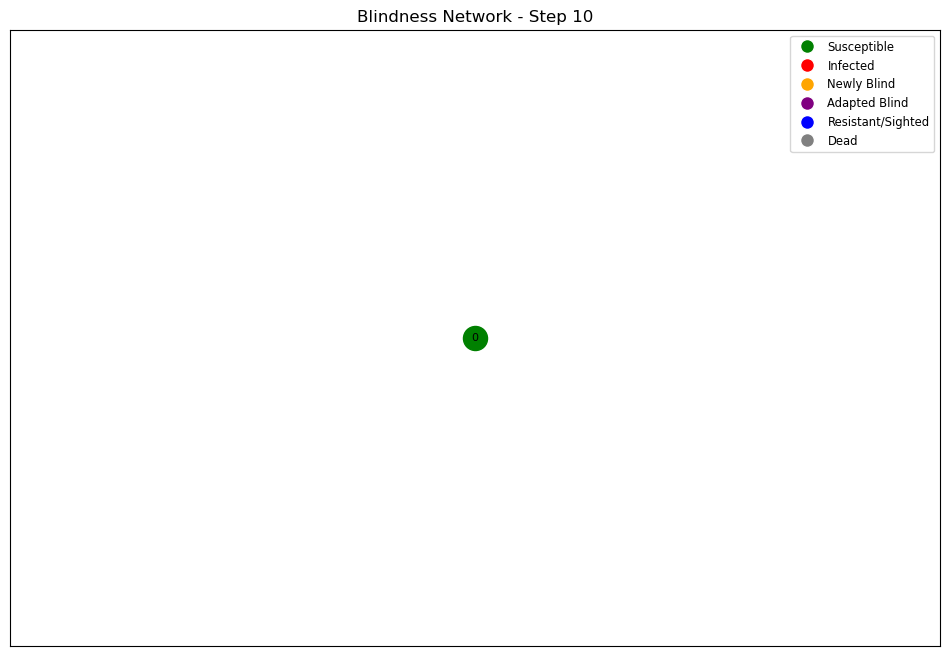

In [8]:
G = nx.Graph()
G.add_node(0)

sim = BlindnessSimulation(population=1, initial_infected=0, resistant_count=0, custom_graph=G)
for step in range(10):
    sim.model.step()
    sim.viz.visualize_network(save_snapshot=True)


### Test Case 2: Infection
This test aims to show how infection works between two nodes and their edge weight. Depending on when you run the code the weight of the edge between nodes will be different, and this may result in an infection or not.

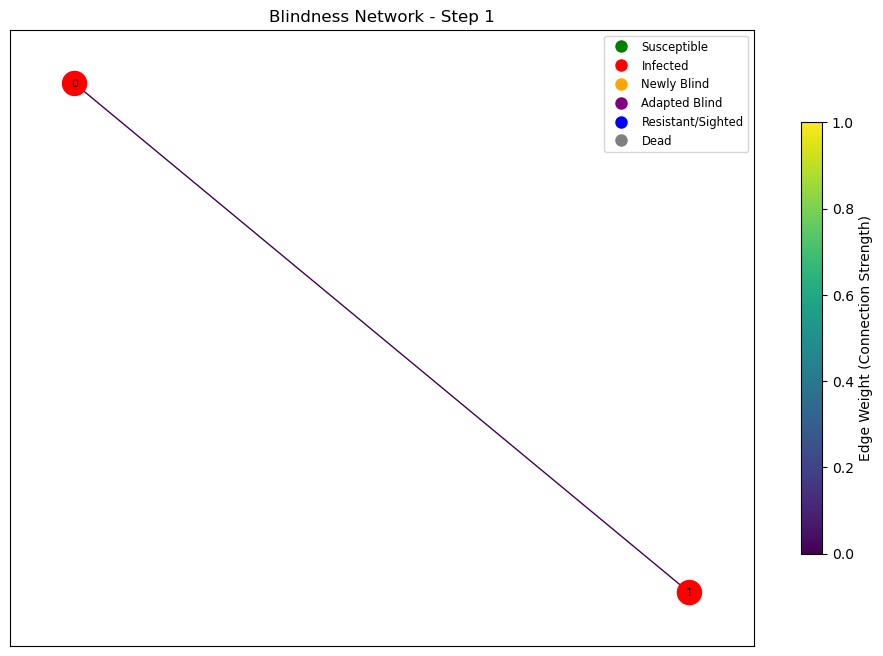

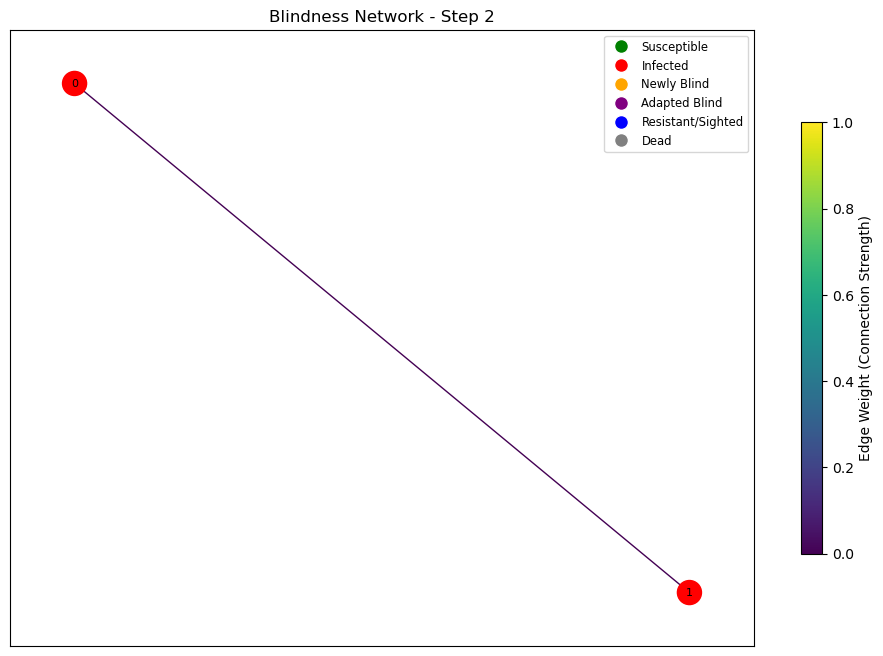

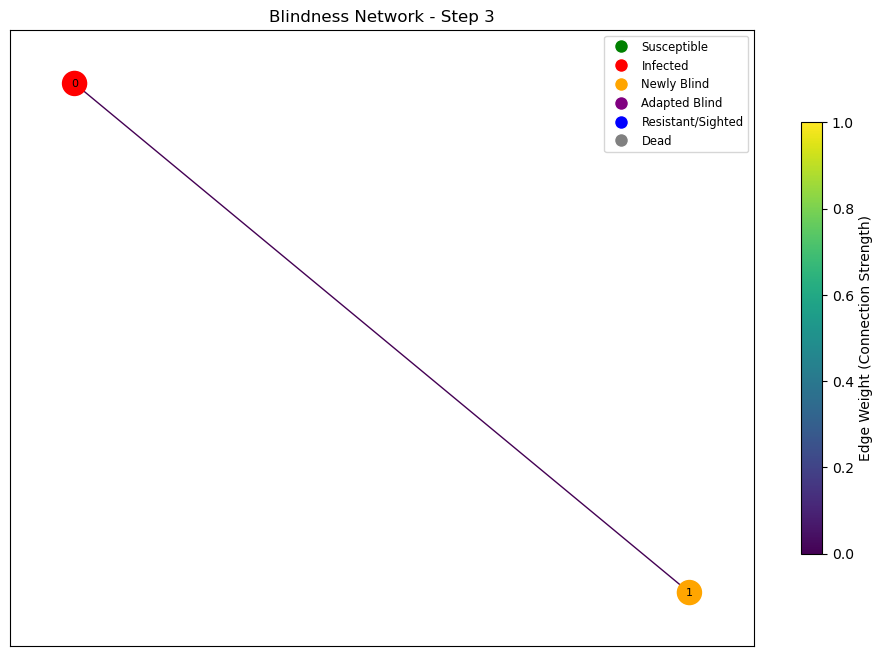

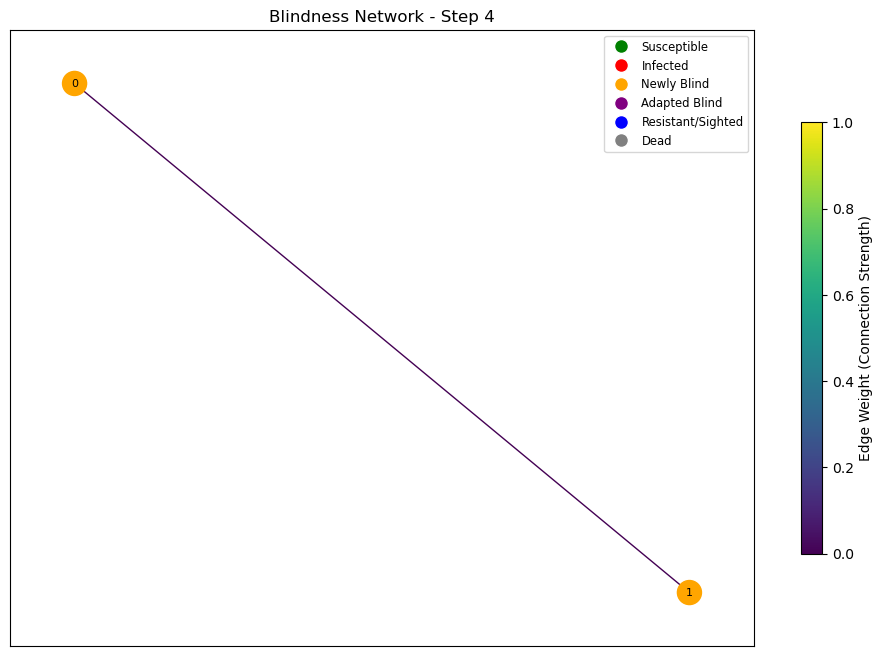

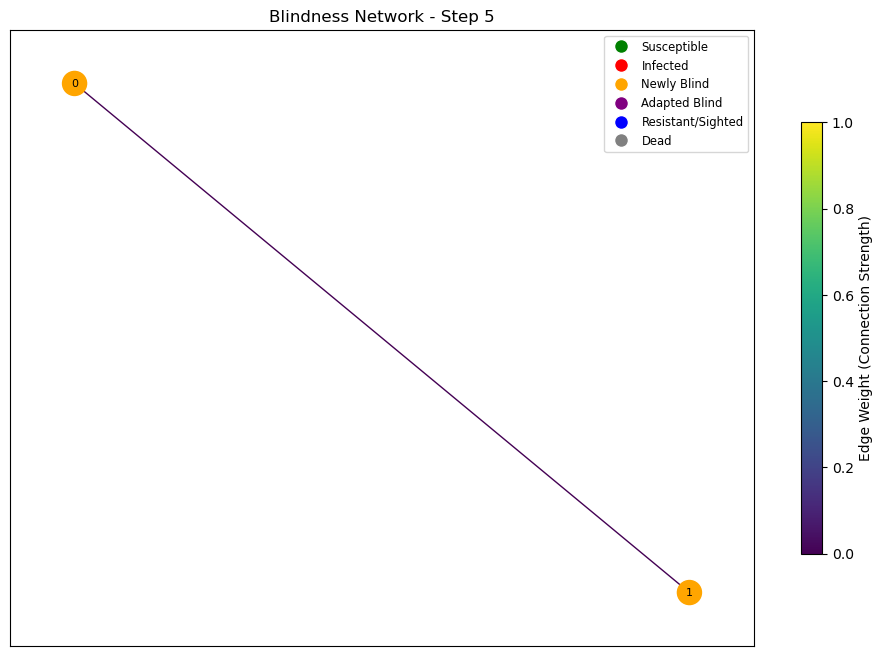

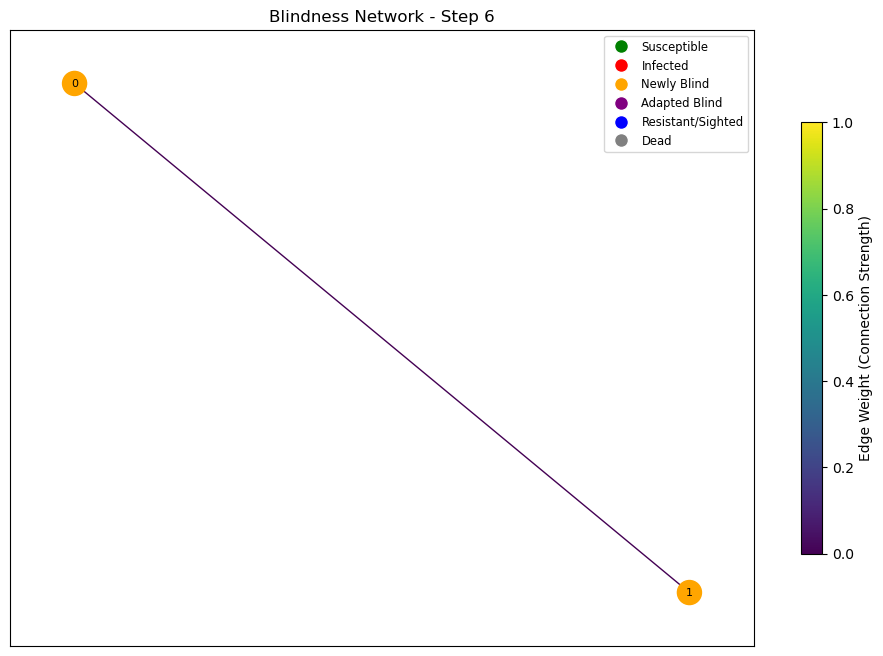

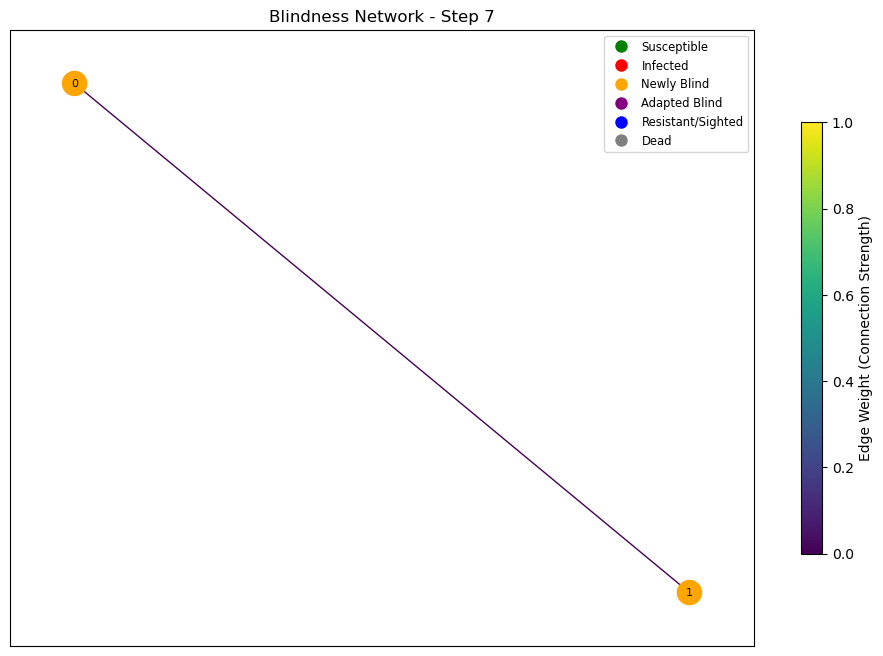

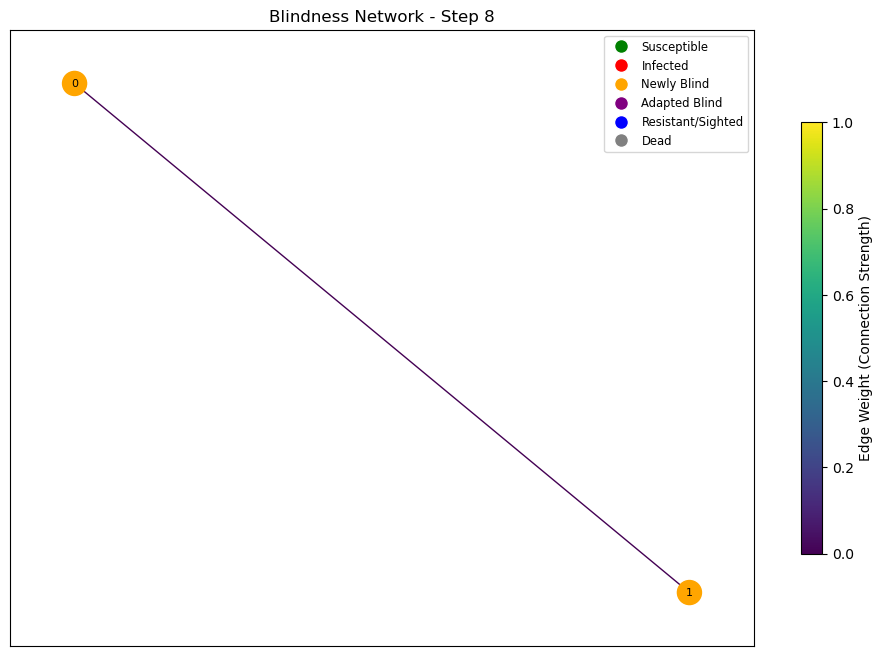

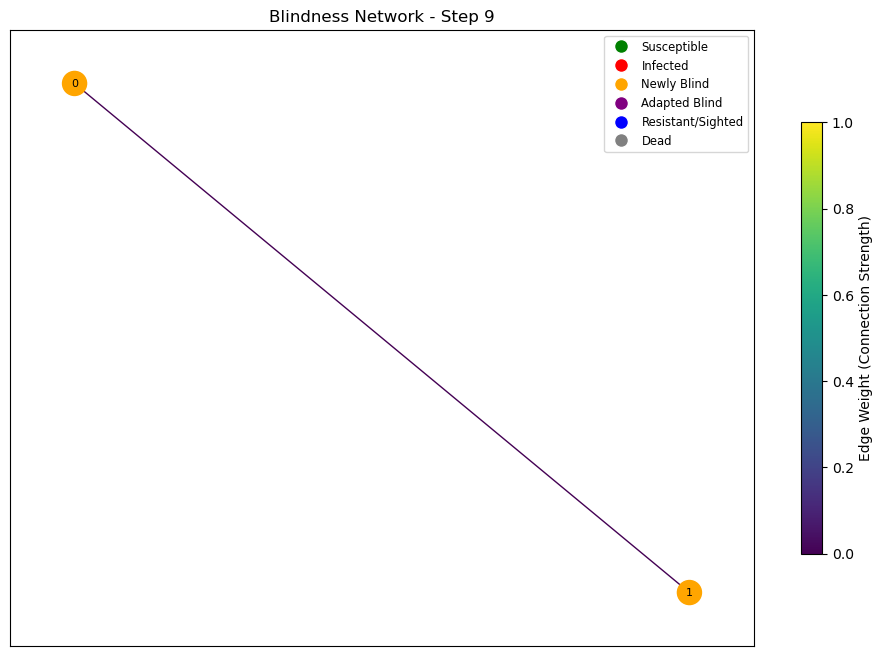

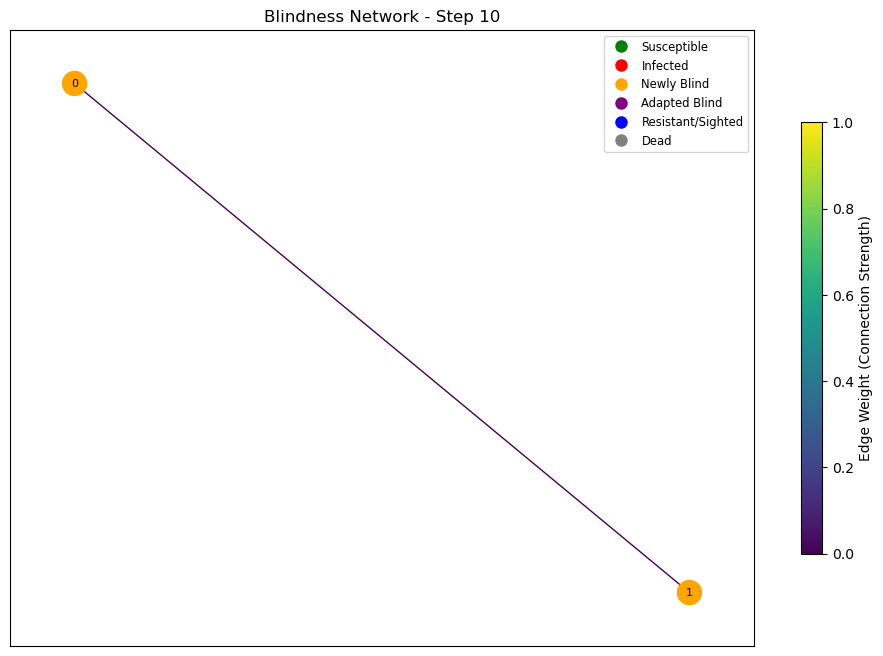

In [9]:
G = nx.Graph()
G.add_nodes_from([0, 1])
G.add_edge(0, 1)

sim = BlindnessSimulation(population=2, initial_infected=1, resistant_count=0, custom_graph=G)
for step in range(10):
    sim.model.step()
    sim.viz.visualize_network(save_snapshot=True)

### Test Case 3: Resistant Nodes
This test aims to show what happens when only resistant nodes are initialized on the network. Their state should not change, and it is expected to see a maintenance and strengthening of the edges.

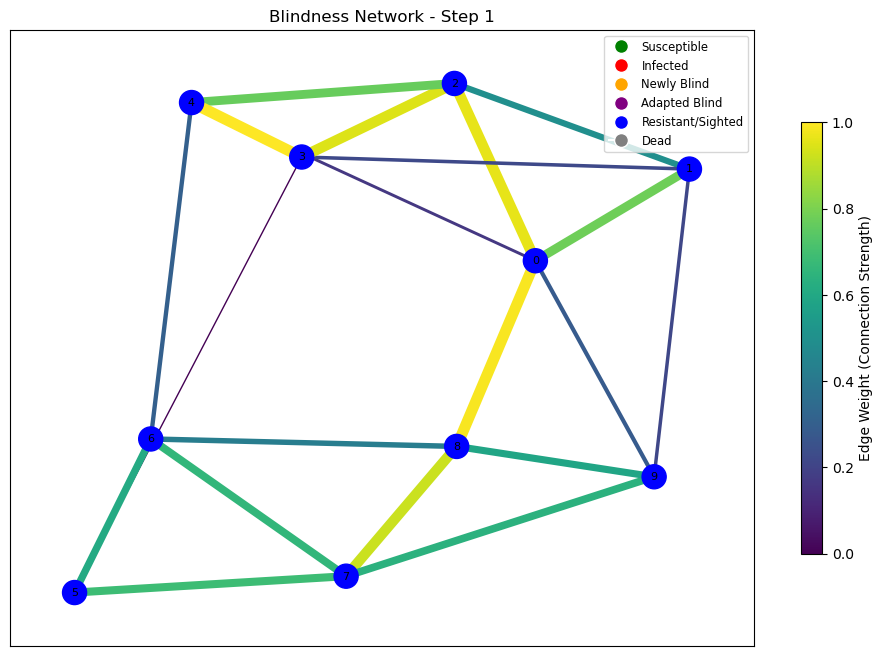

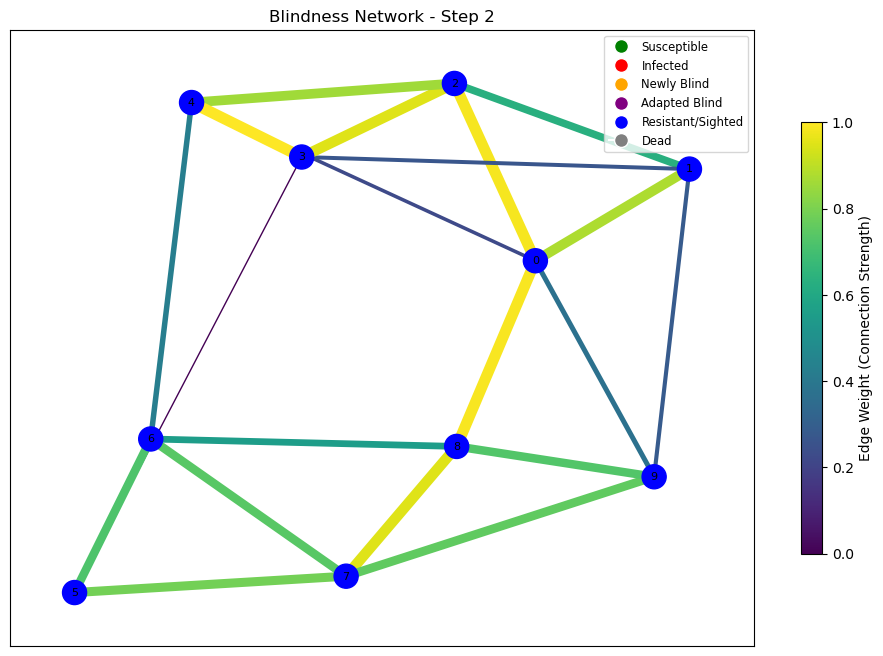

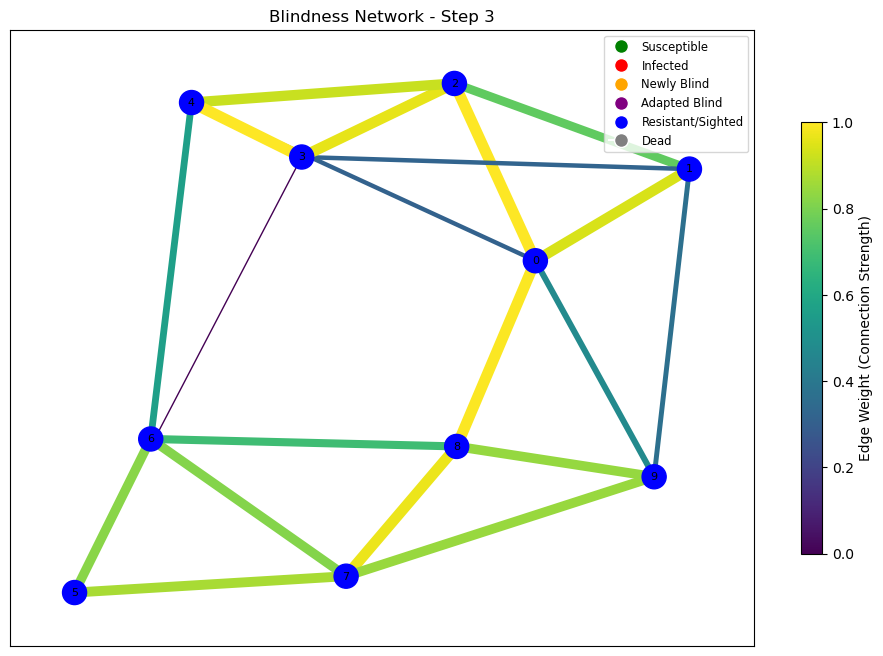

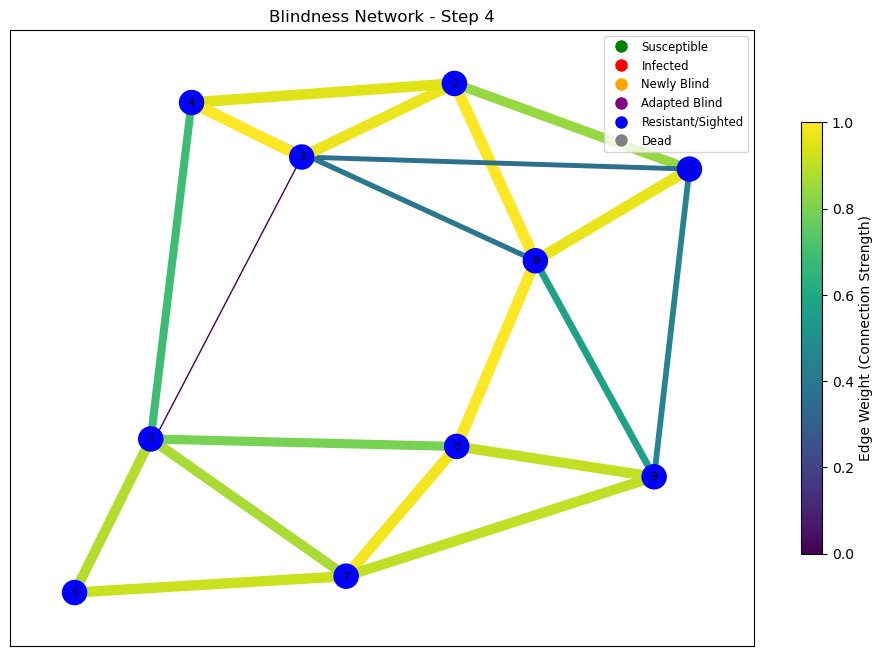

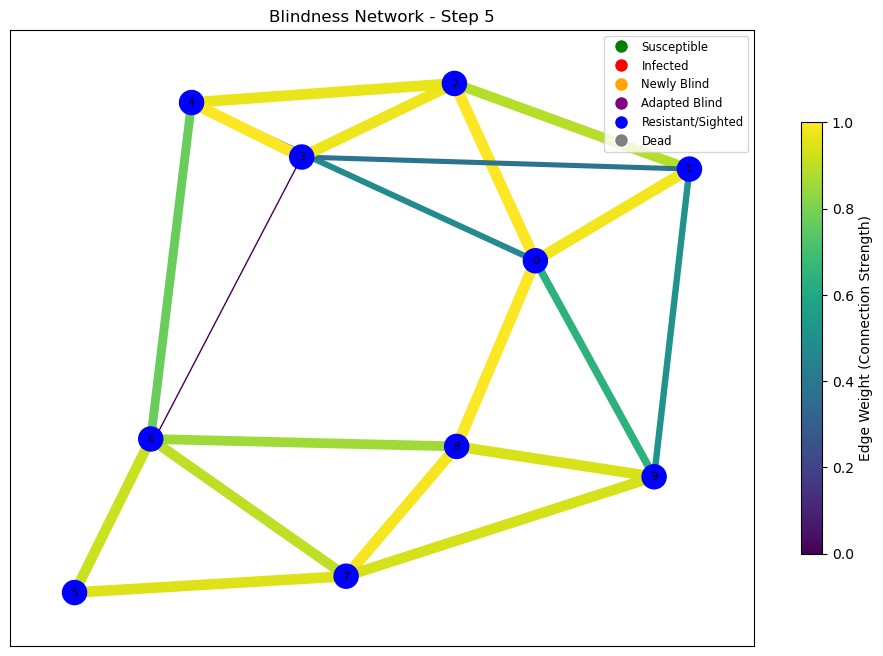

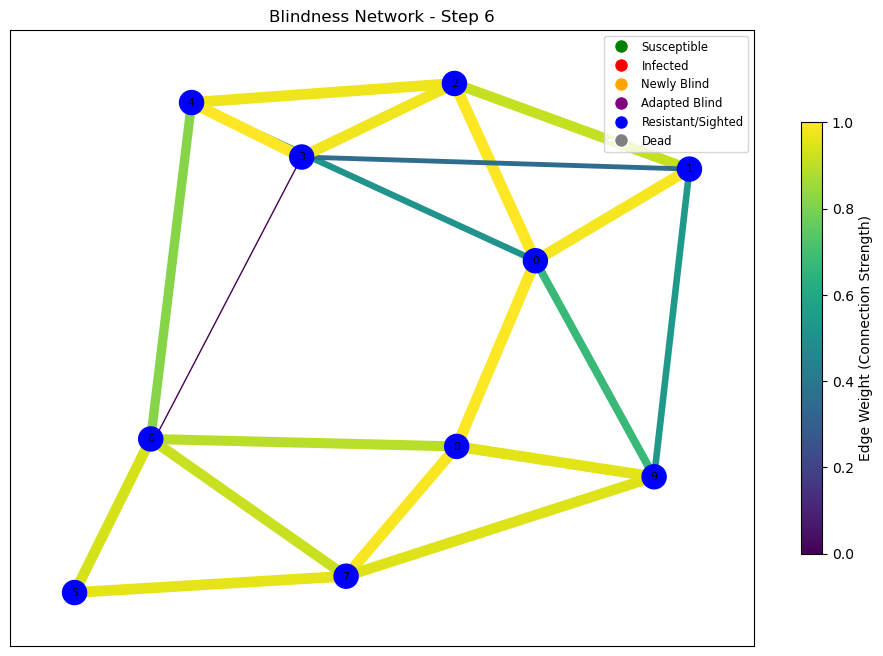

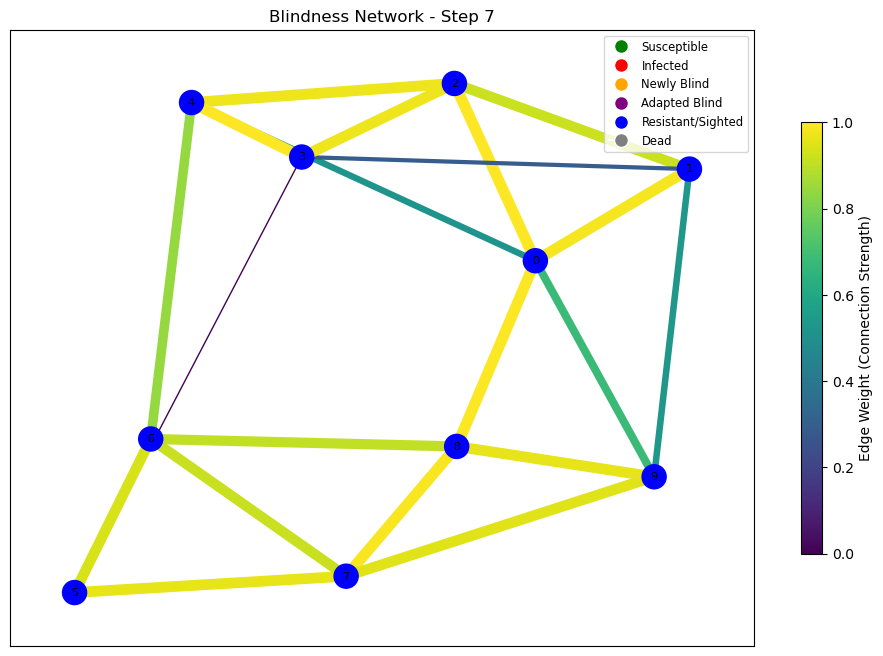

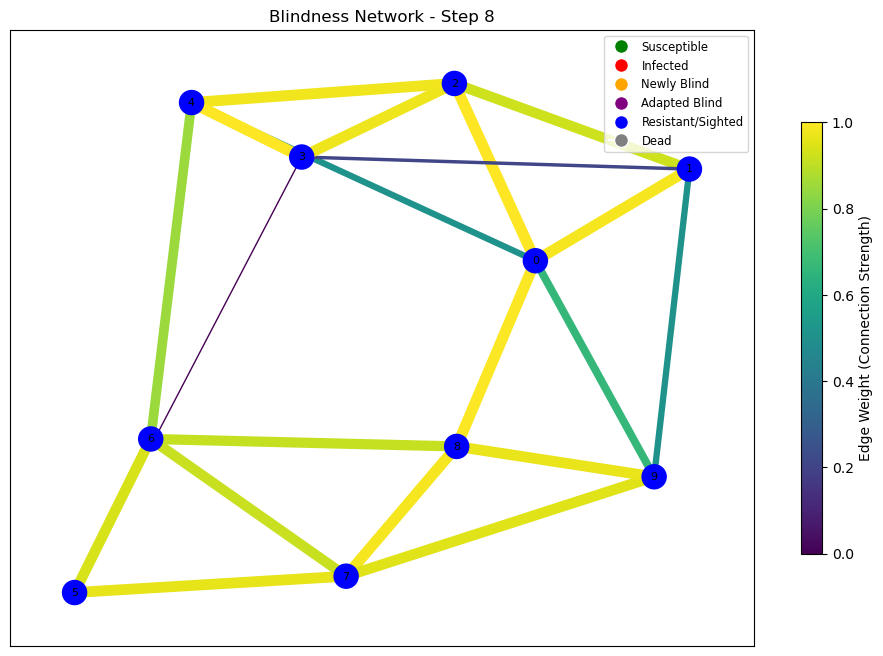

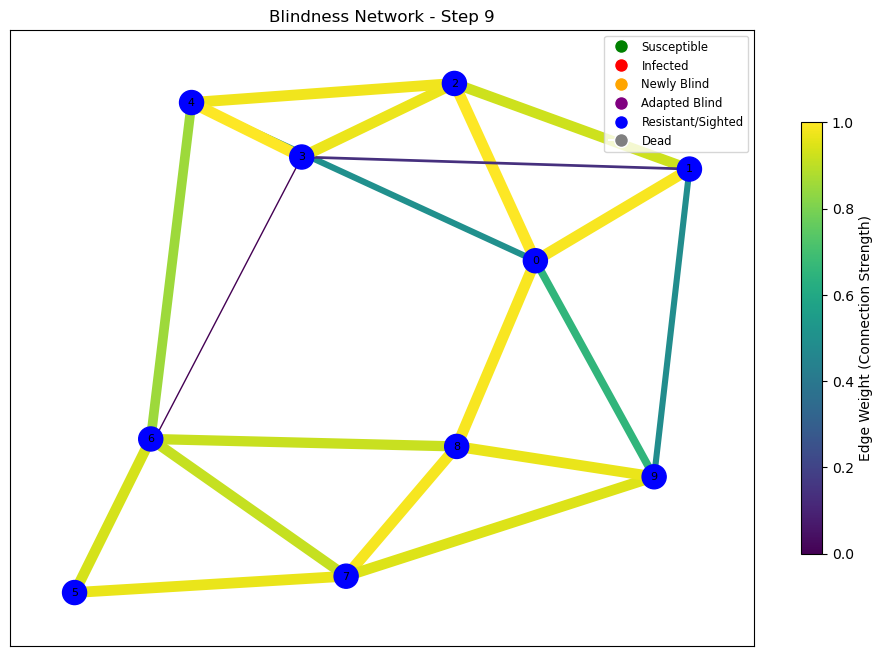

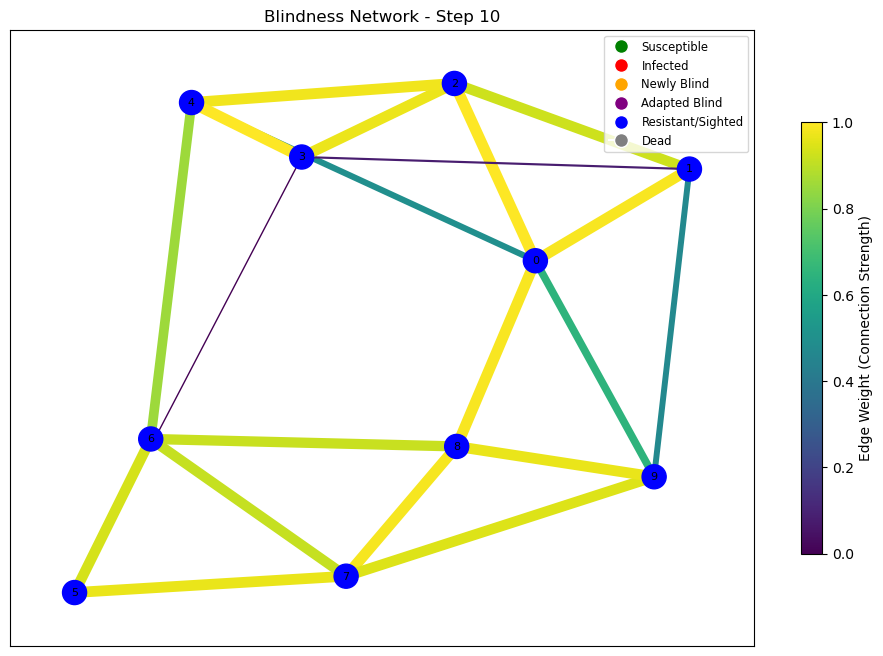

In [10]:
sim = BlindnessSimulation(population=10, initial_infected=0, resistant_count=10)
for step in range(10):
    sim.model.step()
    sim.viz.visualize_network(save_snapshot=True)

### Test Case 4: Only Infected Nodes
This test aims to show what would happen if all nodes of the network are initialized as infected. The test should show the progression of infected --> new blind --> adapted, and some deaths depending on the intialized weights between nodes.

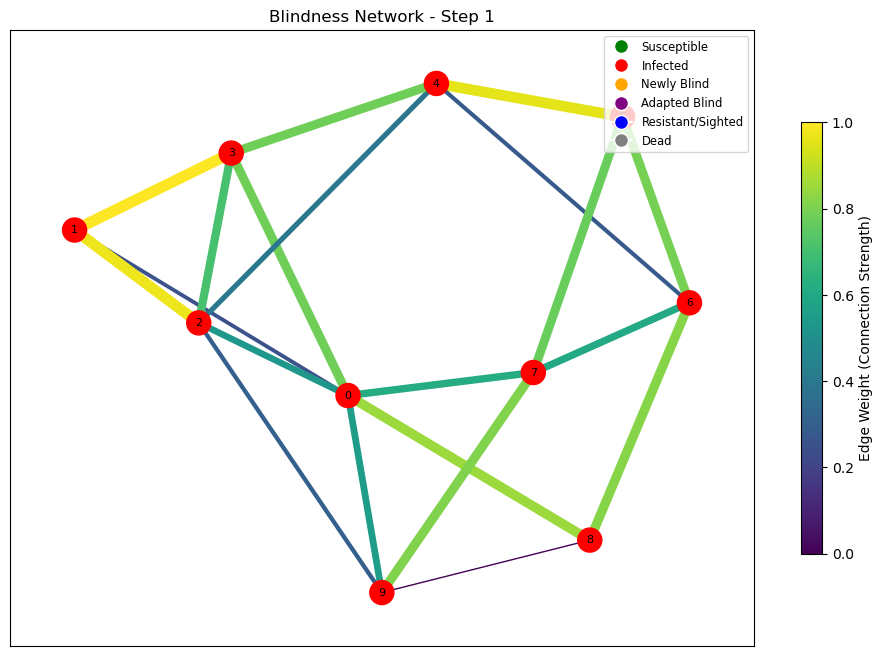

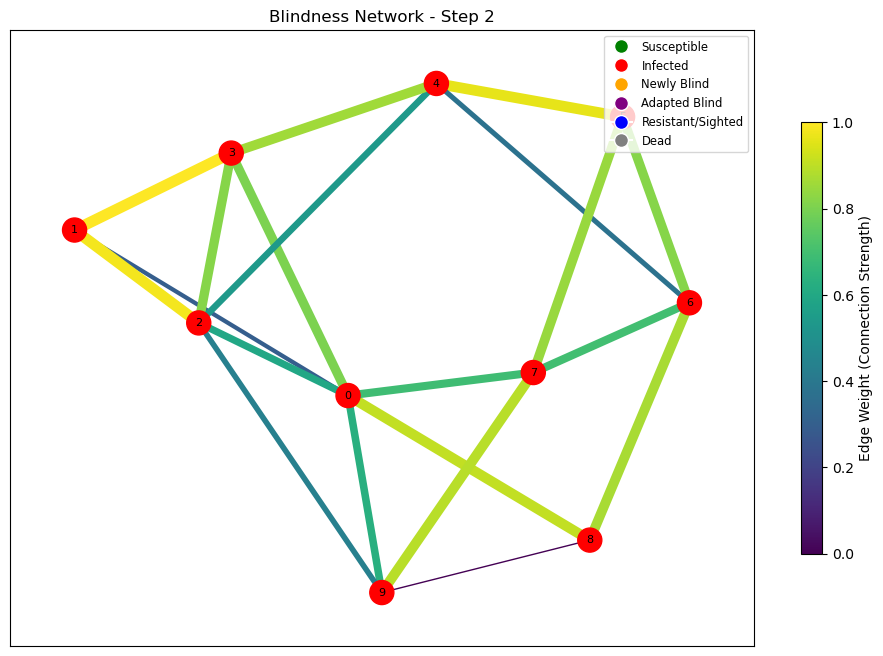

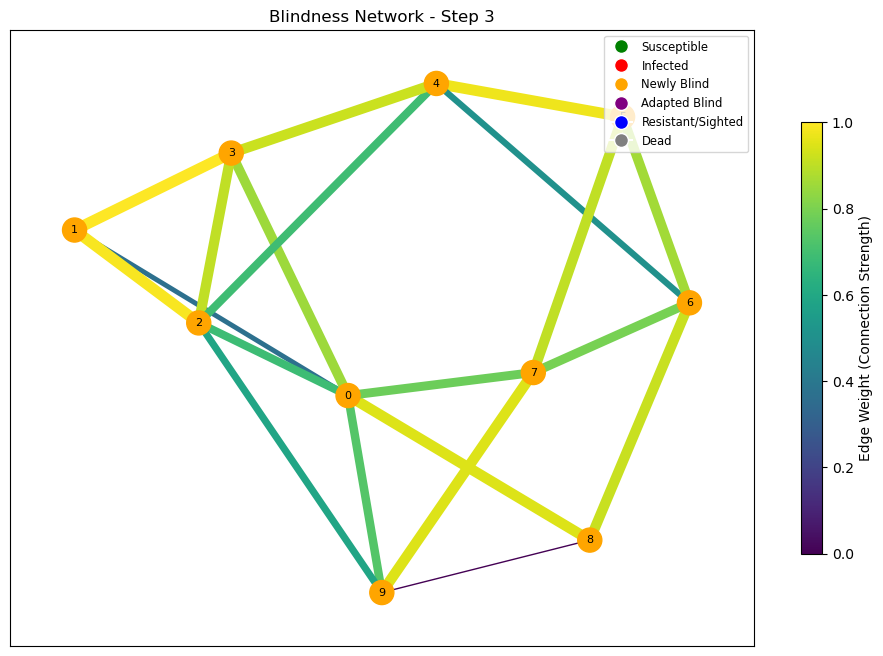

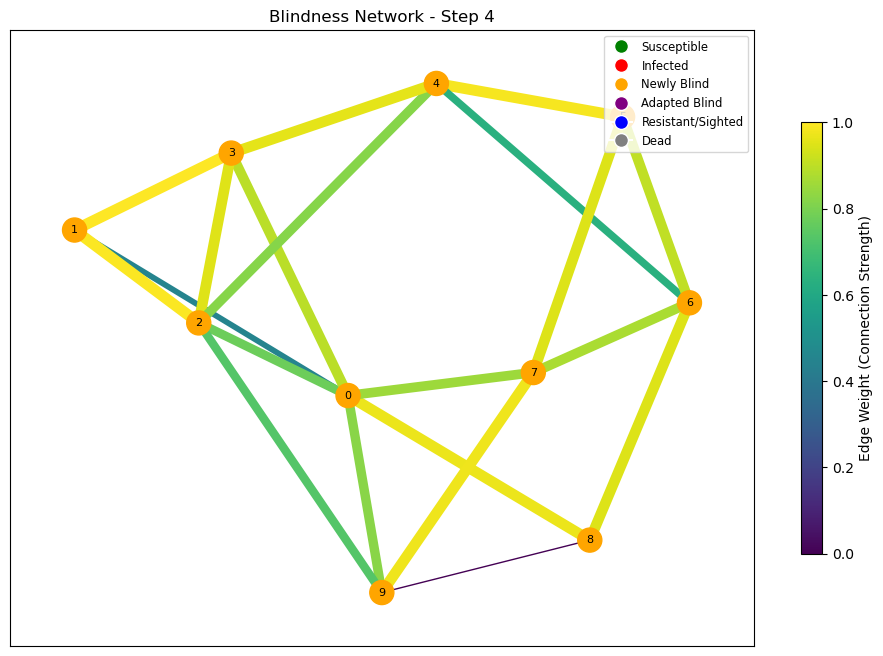

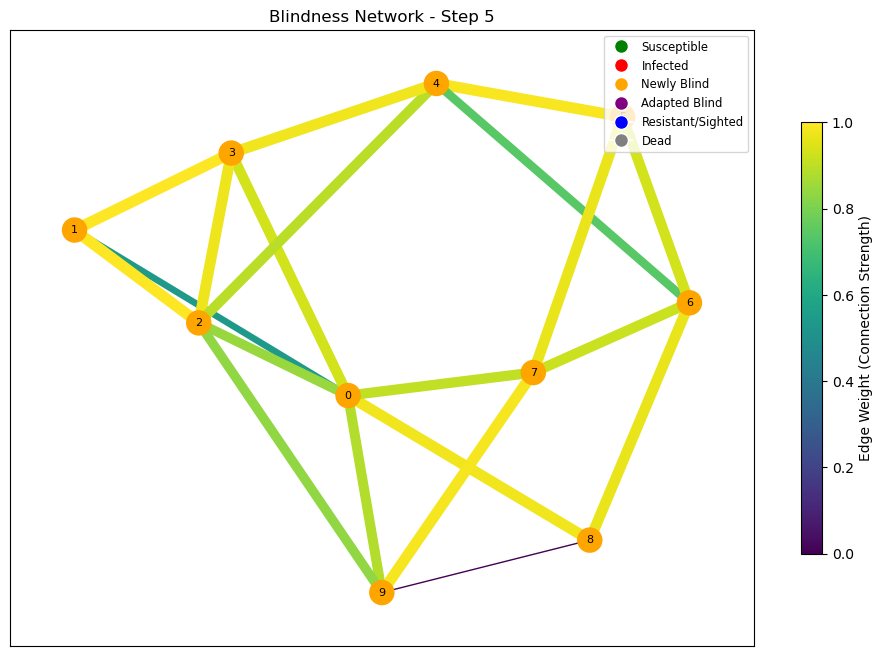

...

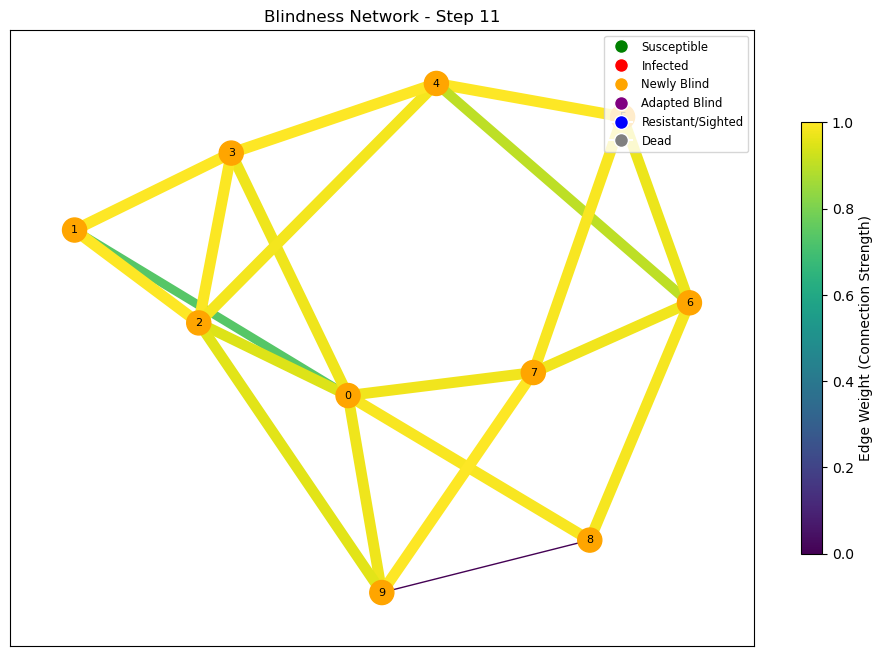

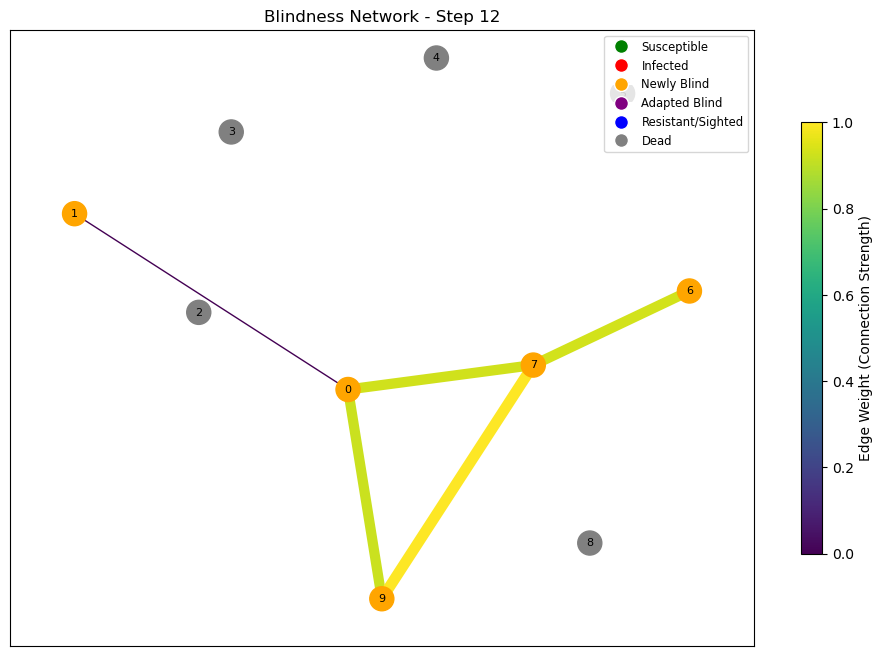

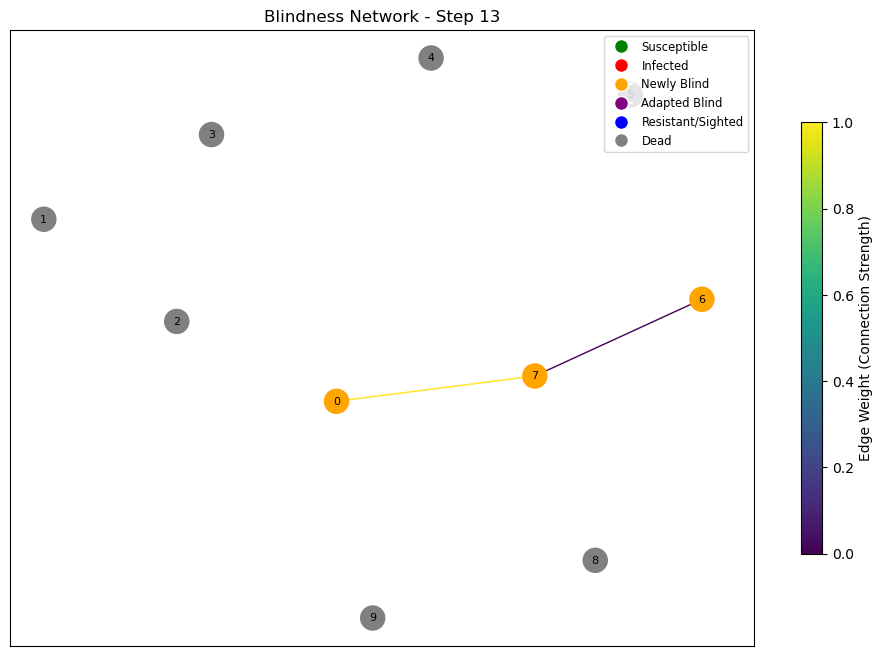

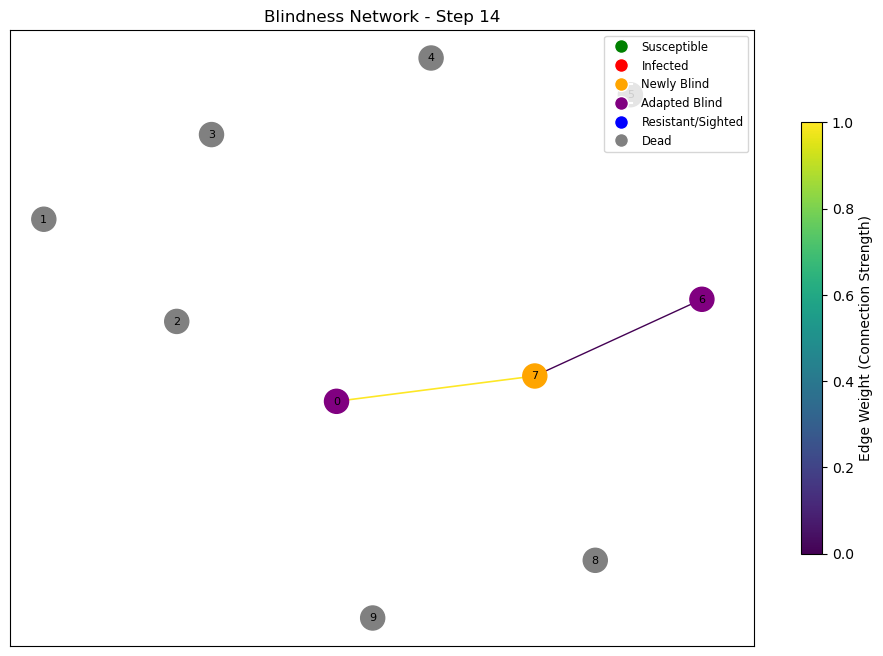

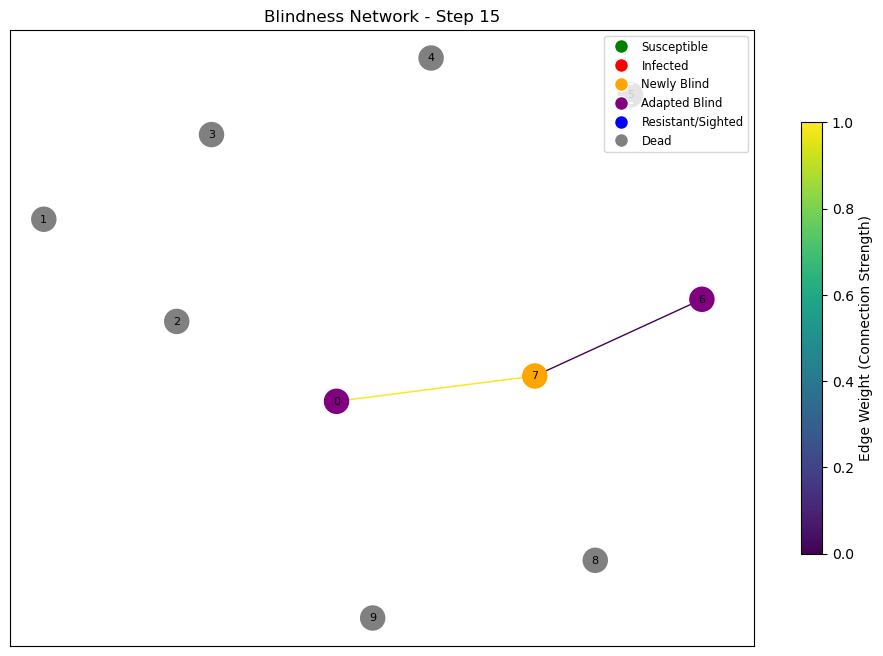

In [11]:
sim = BlindnessSimulation(population=10, initial_infected=10, resistant_count=0)
for step in range(15):
    sim.model.step()
    sim.viz.visualize_network(save_snapshot=True)

# Empirical Analysis

In [12]:
def run_trials(model_class, population, initial_infected, resistant_count, 
              adaptation_p, trials=500, steps=100):
    """
    Run multiple independent simulation trials to estimate survival statistics.

    Parameters:
        model_class (class): The model class to instantiate (e.g., BlindnessModel).
        population (int): Total number of individuals in each simulation.
        initial_infected (int): Number of initially infected individuals.
        resistant_count (int): Number of initially resistant (sighted) individuals.
        adaptation_p (float): Adaptation probability for newly blind individuals.
        trials (int, optional): Number of trials to run. Default is 500.
        steps (int, optional): Number of steps per simulation. Default is 100.

    Returns:
        dict: Dictionary containing the mean, standard deviation, min, max, 
              and list of survivor counts across trials.
    """
    survival_counts = []
    
    for _ in tqdm(range(trials), desc=f"Resistant: {resistant_count}, Adapt P: {adaptation_p:.1f}"):
        model = model_class(
            population=population,
            initial_infected=initial_infected,
            resistant_count=resistant_count,
            adaptation_p=adaptation_p
        )
        
        results = model.run_simulation(steps=steps)
        
        final_state = results[-1]
        survivors = (final_state['susceptible'] + final_state['infected'] + 
                    final_state['blind'] + final_state['resistant'])
        
        survival_counts.append(survivors)
    
    return {
        'mean': np.mean(survival_counts),
        'std': np.std(survival_counts),
        'min': np.min(survival_counts),
        'max': np.max(survival_counts),
        'counts': survival_counts
    }

def plot_histogram_with_ci(ax, data, label=None):
    """
    Plot a histogram of survivor counts with the mean and 95% confidence interval highlighted.

    Parameters:
        ax (matplotlib.axes.Axes): The matplotlib axis to plot on.
        data (array-like): List or array of survivor counts.
        label (str, optional): Optional label for the histogram.

    Returns:
        matplotlib.axes.Axes: The axis with the plotted histogram and confidence interval lines.
    """
    mean = np.mean(data)
    ci = stats.norm.interval(0.95, loc=mean, scale=np.std(data) / np.sqrt(len(data)))

    # plotting
    ax.hist(data, alpha=0.5, bins=10, label=label)

    ax.axvline(mean, color='red', linestyle='-', label=f'Mean = {mean:.1f}')
    ax.axvline(ci[0], color='purple', linestyle='--', label=f'95% CI = [{ci[0]:.1f}, {ci[1]:.1f}]')
    ax.axvline(ci[1], color='purple', linestyle='--')
    
    ax.legend()

    return ax



def parameter_sweep_analysis(population=100, initial_infected=10, steps=40, trials=100):
    """
    Perform a parameter sweep analysis across different adaptation probabilities
    and resistant counts, generating survival distributions and visualizations.

    Parameters:
        population (int, optional): Total number of individuals per simulation. Default is 100.
        initial_infected (int, optional): Number of initially infected individuals. Default is 10.
        steps (int, optional): Number of steps to run each simulation. Default is 40.
        trials (int, optional): Number of Monte Carlo trials per parameter setting. Default is 100.

    Returns:
        pandas.DataFrame: A dataframe summarizing the survival statistics across all parameter combinations.
    """
    adaptation_p_values = [0.1, 0.3, 0.5, 0.7, 0.9]
    resistant_count_values = [1, 10, 20, 40, 70]
    
    results = []
    
    for adaptation_p in adaptation_p_values:
        for resistant_count in resistant_count_values:
            print(f"\nTesting: adaptation_p={adaptation_p}, resistant_count={resistant_count}")
            
            stats = run_trials(
                BlindnessModel,
                population, 
                initial_infected, 
                resistant_count, 
                adaptation_p,
                trials=trials,
                steps=steps
            )
            
            results.append({
                'adaptation_p': adaptation_p,
                'resistant_count': resistant_count,
                **stats
            })
    
    df = pd.DataFrame(results)
    
    # combined histograms by adaptation_p
    fig, axes = plt.subplots(len(adaptation_p_values), 1, figsize=(12, 4*len(adaptation_p_values)))
    
    for i, p in enumerate(adaptation_p_values):
        ax = axes[i]
        subset = df[df['adaptation_p'] == p]
        
        for resistant in resistant_count_values:
            data = subset[subset['resistant_count'] == resistant]['counts'].iloc[0]
            ax.hist(data, alpha=0.6, bins=10, label=f"Resistant: {resistant}")

        
        ax.set_title(f"Adaptation Probability: {p}")
        ax.set_xlabel("Number of Survivors")
        ax.set_ylabel("Frequency")
        ax.legend()
    
    plt.tight_layout()
    plt.savefig('survival_histograms.png')
    plt.show()
    
    # resistant count for this slice analysis
    fixed_resistant_count = 10
    fig, axes = plt.subplots(1, len(adaptation_p_values), figsize=(18, 4))

    for i, p in enumerate(adaptation_p_values):
        subset = df[
            (df['adaptation_p'] == p) &
            (df['resistant_count'] == fixed_resistant_count)
        ]

        # grab 'counts' and flatten
        data = subset['counts'].values[0]

        plot_histogram_with_ci(axes[i], data)
        axes[i].set_title(f'adaptation_p = {p}')

    plt.suptitle(f'Distribution of Survivors (Resistant Count = {fixed_resistant_count})')
    plt.tight_layout()
    plt.show()


    # histograms for resistant_count
    fixed_adaptation_p = 0.3
    fig, axes = plt.subplots(1, len(resistant_count_values), figsize=(18, 4))

    for i, r in enumerate(resistant_count_values):
        subset = df[
            (df['resistant_count'] == r) &
            (df['adaptation_p'] == fixed_adaptation_p)
        ]

        data = subset['counts'].values[0]

        plot_histogram_with_ci(axes[i], data)
        axes[i].set_title(f'resistant_count = {r}')

    plt.suptitle(f'Distribution of Survivors (Adaptation Probability = {fixed_adaptation_p})')
    plt.tight_layout()
    plt.show()


    plt.figure(figsize=(10, 8))
    pivot_df = df.pivot(index='resistant_count', columns='adaptation_p', values='mean')
    sns.heatmap(pivot_df, annot=True, fmt='.1f', cmap='viridis')
    plt.title('Mean Number of Survivors')
    plt.xlabel('Adaptation Probability')
    plt.ylabel('Initial Resistant Count')
    plt.savefig('survival_heatmap.png')
    plt.show()
    
    return df



Testing: adaptation_p=0.1, resistant_count=1


Resistant: 1, Adapt P: 0.1:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.1, resistant_count=10


Resistant: 10, Adapt P: 0.1:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.1, resistant_count=20


Resistant: 20, Adapt P: 0.1:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.1, resistant_count=40


Resistant: 40, Adapt P: 0.1:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.1, resistant_count=70


Resistant: 70, Adapt P: 0.1:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.3, resistant_count=1


Resistant: 1, Adapt P: 0.3:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.3, resistant_count=10


Resistant: 10, Adapt P: 0.3:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.3, resistant_count=20


Resistant: 20, Adapt P: 0.3:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.3, resistant_count=40


Resistant: 40, Adapt P: 0.3:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.3, resistant_count=70


Resistant: 70, Adapt P: 0.3:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.5, resistant_count=1


Resistant: 1, Adapt P: 0.5:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.5, resistant_count=10


Resistant: 10, Adapt P: 0.5:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.5, resistant_count=20


Resistant: 20, Adapt P: 0.5:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.5, resistant_count=40


Resistant: 40, Adapt P: 0.5:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.5, resistant_count=70


Resistant: 70, Adapt P: 0.5:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.7, resistant_count=1


Resistant: 1, Adapt P: 0.7:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.7, resistant_count=10


Resistant: 10, Adapt P: 0.7:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.7, resistant_count=20


Resistant: 20, Adapt P: 0.7:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.7, resistant_count=40


Resistant: 40, Adapt P: 0.7:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.7, resistant_count=70


Resistant: 70, Adapt P: 0.7:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.9, resistant_count=1


Resistant: 1, Adapt P: 0.9:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.9, resistant_count=10


Resistant: 10, Adapt P: 0.9:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.9, resistant_count=20


Resistant: 20, Adapt P: 0.9:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.9, resistant_count=40


Resistant: 40, Adapt P: 0.9:   0%|          | 0/500 [00:00<?, ?it/s]


Testing: adaptation_p=0.9, resistant_count=70


Resistant: 70, Adapt P: 0.9:   0%|          | 0/500 [00:00<?, ?it/s]

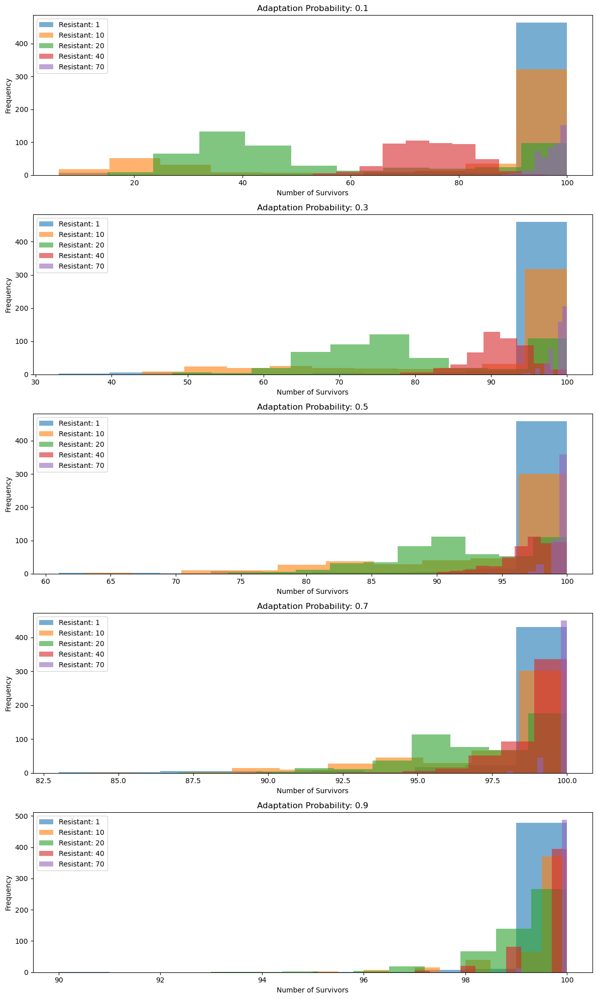

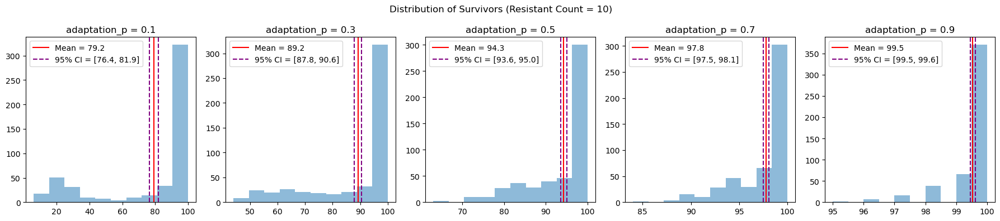

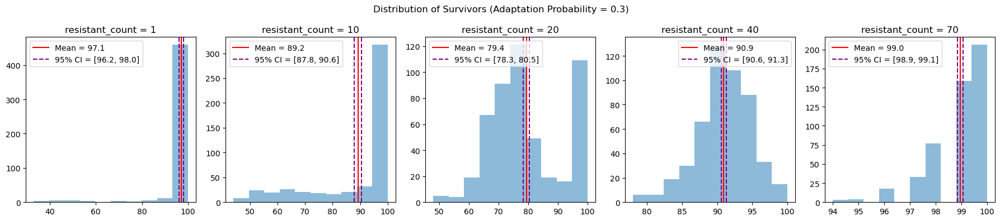

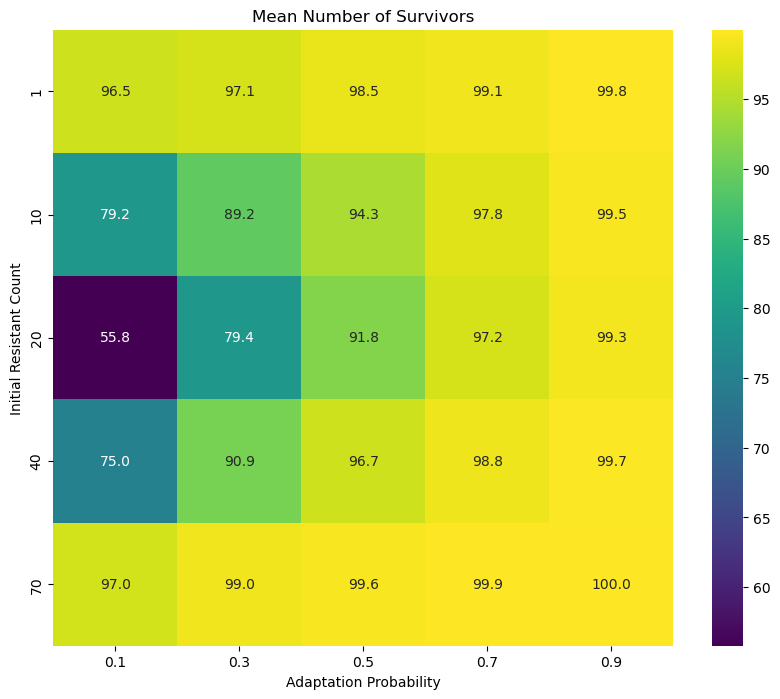

In [13]:
result_df = parameter_sweep_analysis(population=100, initial_infected=10, steps=100, trials=500)

# MFA Analysis

In [14]:
# parameters
k_vals = np.arange(0, 11)  # degree values from 0 to 10
P_k = binom.pmf(k_vals, n=10, p=0.4) # binomial distribution 

k_safe = 1  # needs at least 2 helpful neighbors to survive
p_inf = 0.7 # p of infection

# helper function: death probability for a given degree k and fragility f_d
def p_d(k, f_d, k_safe):
    return sum(binom.pmf(i, k, 1 - f_d) for i in range(0, k_safe))

def f_d(N_vals, I_vals):
    return np.sum(P_k * (N_vals + I_vals))   # "fragility" increases with deaths

def D_next(S_vals, N_vals, A_vals, R_vals):
    f_d_val = np.sum(P_k * (N_vals + I_vals))
    D_increment = np.sum([
        P_k[i] * p_d(k_vals[i], f_d_val, k_safe) *
        (S_vals[i] + N_vals[i] + A_vals[i] + R_vals[i])
        for i in range(len(k_vals))
    ])
    return D_increment 


In [15]:
def run_mfa(population, initial_infected, resistant_count, adaptation_p, steps=40):
    # initialize vectors
    D_k = np.zeros_like(k_vals, dtype=float) # start with no dead nodes at t=0
    
    I_frac = initial_infected / population
    R_frac = resistant_count / population

    # distribute evenly across k-values
    I_k = I_frac * P_k
    R_k = R_frac * P_k

    S_frac = 1.0 - I_frac - R_frac
    S_k = S_frac * P_k
    
    N_k = np.zeros_like(k_vals, dtype=float)
    A_k = np.zeros_like(k_vals, dtype=float)

    for _ in range(steps):
        theta = np.sum(P_k * k_vals * I_k) / np.sum(P_k * k_vals)
        fd = np.sum(P_k * (N_k + I_k))

        pd_vec = np.array([p_d(k, fd, k_safe) for k in k_vals])

        # transitions
        S_to_D = S_k * pd_vec
        S_to_I = S_k * (1 - pd_vec) * (1 - (1 - p_inf * theta) ** k_vals)
        I_to_N = (1/3) * (I_k)
        N_to_A = adaptation_p * N_k / 10  # ~10 steps to adapt
        N_to_D = N_k * pd_vec
        A_to_D = A_k * pd_vec
        R_to_D = R_k * pd_vec

        # updates
        D_k += S_to_D + N_to_D + A_to_D + R_to_D
        S_k = S_k - S_to_D - S_to_I
        I_k = I_k - I_to_N + S_to_I
        N_k = N_k - N_to_A - N_to_D + I_to_N
        A_k = A_k - A_to_D + N_to_A
        R_k = R_k - R_to_D
        

    survivors = np.sum((S_k + I_k + N_k + A_k + R_k))
    deaths = np.sum(D_k)
    return {'survivors': survivors, 'deaths': deaths}


In [16]:
def mfa_parameter_sweep():
    "Function to sweep the parameters and calculate the different MFA outputs."
    adaptation_p_values = [0.1, 0.3, 0.5, 0.7, 0.9]
    resistant_count_values = [1, 10, 20, 40, 70]
    
    mfa_results = []
    for adaptation_p in adaptation_p_values:
        for resistant_count in resistant_count_values:
            result = run_mfa(
                population=100,
                initial_infected=10,
                resistant_count=resistant_count,
                adaptation_p=adaptation_p,
                steps=40
            )
            mfa_results.append({
                'adaptation_p': adaptation_p,
                'resistant_count': resistant_count,
                **result
            })
    return pd.DataFrame(mfa_results)


In [17]:
mfa_df = mfa_parameter_sweep()

# convert MFA values to counts (instead of proportions)
mfa_df['survivors'] = mfa_df['survivors'] * 100
mfa_df['deaths'] = mfa_df['deaths'] * 100

# MFA predictions
for _, row in mfa_df.iterrows():
    print(f"adaptation_p = {row['adaptation_p']:.1f}, "
          f"resistant_count = {int(row['resistant_count'])} → "
          f"MFA Survivors: {row['survivors']:.1f}, MFA Deaths: {row['deaths']:.1f}")


adaptation_p = 0.1, resistant_count = 1 → MFA Survivors: 91.8, MFA Deaths: 8.2
adaptation_p = 0.1, resistant_count = 10 → MFA Survivors: 92.9, MFA Deaths: 7.1
adaptation_p = 0.1, resistant_count = 20 → MFA Survivors: 94.0, MFA Deaths: 6.0
adaptation_p = 0.1, resistant_count = 40 → MFA Survivors: 95.6, MFA Deaths: 4.4
adaptation_p = 0.1, resistant_count = 70 → MFA Survivors: 96.9, MFA Deaths: 3.1
adaptation_p = 0.3, resistant_count = 1 → MFA Survivors: 93.3, MFA Deaths: 6.7
adaptation_p = 0.3, resistant_count = 10 → MFA Survivors: 94.1, MFA Deaths: 5.9
adaptation_p = 0.3, resistant_count = 20 → MFA Survivors: 94.9, MFA Deaths: 5.1
adaptation_p = 0.3, resistant_count = 40 → MFA Survivors: 96.2, MFA Deaths: 3.8
adaptation_p = 0.3, resistant_count = 70 → MFA Survivors: 97.4, MFA Deaths: 2.6
adaptation_p = 0.5, resistant_count = 1 → MFA Survivors: 94.2, MFA Deaths: 5.8
adaptation_p = 0.5, resistant_count = 10 → MFA Survivors: 94.9, MFA Deaths: 5.1
adaptation_p = 0.5, resistant_count = 20 → 